In [64]:
import pandas as pd
import re

# Define a function to extract IDs from the string format
def extract_ids(s):
    return re.findall(r'\[(\d+)\]', s)

# Read CSV files
floor_plan = pd.read_csv(r"C:\Users\Georgios Bekakos\Desktop\LEVEL 04_floor_plan.csv")
all_walls = pd.read_csv(r"C:\Users\Georgios Bekakos\Desktop\all_walls_info.csv")

# Extract all IDs from 'Touching Walls IDs' column
all_ids = floor_plan['Touching Wall Unique IDs'].apply(extract_ids).explode().dropna().unique()

# Check if those IDs exist in 'all_walls_info.csv'
existing_ids = all_walls['Wall Unique ID'].apply(str)  # Convert the Wall ID column values to string for matching
matching_ids = [id_ for id_ in all_ids if id_ in existing_ids.values]

print(f"Total unique Touching Wall IDs: {len(all_ids)}")
print(f"Number of those IDs existing in all_walls_info.csv: {len(matching_ids)}")
print("Matching IDs:", matching_ids)


Total unique Touching Wall IDs: 0
Number of those IDs existing in all_walls_info.csv: 0
Matching IDs: []


MERGED NODES

In [65]:
import pandas as pd

# Initialize an empty list to store the DataFrames
dfs = []

# Loop through the level numbers to read and merge the files
for i in range(1, 7):  # Loop from 1 to 6
    # Read the CSV file into a DataFrame
    df = pd.read_csv(f"C:\\Users\\Georgios Bekakos\\Desktop\\LEVEL 0{i}_floor_plan.csv")
    
    # Drop the column named 'Index'
    if 'Index' in df.columns:
        df = df.drop('Index', axis=1)
    
    # Add a 'Level' column to indicate the source file
    df['Level'] = i
    
    # Append the DataFrame to the list
    dfs.append(df)

# Remove duplicates based on 'Room Number', 'Room Name', 'Room Unique ID'
# and keep the one with the highest 'Area'
merged_df = merged_df.sort_values('Area', ascending=False)
merged_df = merged_df.drop_duplicates(subset=['Room Number', 'Room Name', 'Room Unique ID'], keep='first')
merged_df.sort_index(inplace=True)

# Reset the index to make 'Index' column unique
merged_df.reset_index(drop=True, inplace=True)

# Add a new 'Index' column at the beginning of the DataFrame
merged_df.reset_index(inplace=True)
merged_df = merged_df.rename(columns={'index': 'Index'})

# Drop any extra 'Index' columns
merged_df = merged_df.loc[:, ~merged_df.columns.duplicated()]

# Save the merged DataFrame to a new CSV file
merged_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv", index=False)





MERGED EDGES

In [85]:
import pandas as pd

# Step 1: Merge the six edgelist_info_XX files
dfs_edges = []
for i in range(1, 7):
    df = pd.read_csv(f"C:\\Users\\Georgios Bekakos\\Desktop\\edgelist_info_0{i}.csv")
    dfs_edges.append(df)
merged_edges = pd.concat(dfs_edges, ignore_index=True)

# Step 2: Empty the vi and vj columns
merged_edges['vi'] = ''
merged_edges['vj'] = ''

# Step 3: Read the merged_nodes.csv file
merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")

# Create a mapping from Room Unique ID to Index
mapping = merged_nodes.set_index('Room Unique ID')['Index'].to_dict()

# Fill in the vi and vj columns based on matching Room Unique IDs
merged_edges['vi'] = merged_edges['vi Room Unique ID'].map(mapping)
merged_edges['vj'] = merged_edges['vj Room Unique ID'].map(mapping)

# Save the merged_edges DataFrame to a new CSV file
merged_edges.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_edgelist.csv", index=False)


In [86]:
import pandas as pd

# Read the merged_edgelist.csv and all_walls_info.csv files
merged_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_edgelist.csv")
all_walls_info = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\all_walls_info.csv")

# Initialize new columns in merged_edgelist
merged_edgelist['Access'] = ''
merged_edgelist['Wall Footprint'] = ''

# Create mappings from Wall Unique ID to Number of Doors and Wall Footprint
mapping_to_doors = all_walls_info.set_index('Wall Unique ID')['Number of Doors'].to_dict()
mapping_to_footprint = all_walls_info.set_index('Wall Unique ID')['Wall Footprint'].to_dict()

# Populate the Access and Wall Footprint columns in merged_edgelist
merged_edgelist['Access'] = merged_edgelist['Wall Unique ID'].map(mapping_to_doors).apply(lambda x: 0 if x == 0 else 1)
merged_edgelist['Wall Footprint'] = merged_edgelist['Wall Unique ID'].map(mapping_to_footprint)

# Save the updated merged_edgelist DataFrame to a new CSV file
merged_edgelist.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_edgelist.csv", index=False)


filter duplicates

In [87]:
import pandas as pd

# Read the existing merged_edgelist.csv
merged_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_edgelist.csv")

# Sort the DataFrame by 'vi', 'vj', 'Access', and 'Wall Footprint'
# Sorting in descending order for 'Access' and 'Wall Footprint' so that rows with 1 and higher values come first
merged_edgelist.sort_values(['vi', 'vj', 'Access', 'Wall Footprint'], ascending=[True, True, False, False], inplace=True)

# Drop duplicate rows based on 'vi' and 'vj', keeping the first occurrence (which will have Access=1 and highest Wall Footprint)
merged_edgelist.drop_duplicates(subset=['vi', 'vj'], keep='first', inplace=True)

# Save the filtered DataFrame to a new CSV file
merged_edgelist.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_filtered_edgelist.csv", index=False)


In [75]:
import pandas as pd

# Step 1: Read the merged_nodes.csv and merged_vertical_edgelist.csv files
merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
merged_vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Step 2: Empty the vi and vj columns
merged_vertical_edgelist['vi'] = ''
merged_vertical_edgelist['vj'] = ''
merged_vertical_edgelist['Source Room Unique ID'] = ''
merged_vertical_edgelist['Target Room Unique ID'] = ''

# Step 3: Fill in the vi, vj, Source Room Unique ID and Target Room Unique ID columns based on matching Level and Room Number

# Create mappings from Level and Room Number to Index and Room Unique ID
mapping_to_index = merged_nodes.set_index(['Level', 'Room Number'])['Index'].to_dict()
mapping_to_unique_id = merged_nodes.set_index(['Level', 'Room Number'])['Room Unique ID'].to_dict()

# Populate the vi and vj columns, and Source Room Unique ID and Target Room Unique ID
merged_vertical_edgelist['vi'] = merged_vertical_edgelist.apply(lambda row: mapping_to_index.get((row['Source Level'], row['Source Room Number']), ''), axis=1)
merged_vertical_edgelist['vj'] = merged_vertical_edgelist.apply(lambda row: mapping_to_index.get((row['Target Level'], row['Target Room Number']), ''), axis=1)

merged_vertical_edgelist['Source Room Unique ID'] = merged_vertical_edgelist.apply(lambda row: mapping_to_unique_id.get((row['Source Level'], row['Source Room Number']), ''), axis=1)
merged_vertical_edgelist['Target Room Unique ID'] = merged_vertical_edgelist.apply(lambda row: mapping_to_unique_id.get((row['Target Level'], row['Target Room Number']), ''), axis=1)

# Save the updated merged_vertical_edgelist DataFrame to a new CSV file
merged_vertical_edgelist.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv", index=False)


In [88]:
import networkx as nx
import pandas as pd
import plotly.graph_objects as go
import ast

# Load Data
nodes_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_filtered_edgelist.csv")
vertical_edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Initialize Graph
G = nx.Graph()

# Color map based on unique Room Names
unique_room_names = nodes_df['Room Name'].unique().tolist()
color_map = {name: idx for idx, name in enumerate(unique_room_names)}

# Add Nodes
for i, row in nodes_df.iterrows():
    pos_tuple = ast.literal_eval(row['Centroid'])  # Assuming Centroid is in the form "(x, y)"
    pos = pos_tuple + (row['Level'] * 10,)  # Assuming Level is numeric and scaling it by 10 for better visibility
    G.add_node(i, label=row['Room Name'], pos=pos)

# Add Horizontal Edges
for i, row in edges_df.iterrows():
    G.add_edge(row['vi'], row['vj'], doors=row['Access'])

# Add Vertical Edges
for i, row in vertical_edges_df.iterrows():
    G.add_edge(row['vi'], row['vj'], doors=1)

# Extract positions and attributes
node_positions = [G.nodes[node]['pos'] for node in G.nodes]
node_colors = [color_map[G.nodes[node]['label']] for node in G.nodes]

edge_positions = [(G.nodes[edge[0]]['pos'], G.nodes[edge[1]]['pos']) for edge in G.edges]
edge_colors = ['red' if G.edges[edge]['doors'] == 0 else 'black' for edge in G.edges]

# 3D Scatter plot for nodes
node_trace = go.Scatter3d(x=[pos[0] for pos in node_positions],
                          y=[pos[1] for pos in node_positions],
                          z=[pos[2] for pos in node_positions],
                          mode='markers',
                          marker=dict(
                              size=6,
                              color=node_colors,
                              colorscale='Viridis'
                          ),
                          hovertext=[G.nodes[node]['label'] for node in G.nodes]
)

# 3D Line plot for edges
edge_trace = go.Scatter3d(x=[pos for edge_pos in edge_positions for pos in [edge_pos[0][0], edge_pos[1][0], None]],
                          y=[pos for edge_pos in edge_positions for pos in [edge_pos[0][1], edge_pos[1][1], None]],
                          z=[pos for edge_pos in edge_positions for pos in [edge_pos[0][2], edge_pos[1][2], None]],
                          mode='lines',
                          line=dict(color=edge_colors, width=4)
)

# Create Plot
layout = go.Layout(
    scene=dict(
        xaxis=dict(nticks=4),
        yaxis=dict(nticks=4),
        zaxis=dict(nticks=4)
    ),
    showlegend=True
)

fig = go.Figure(data=[node_trace, edge_trace], layout=layout)
fig.show()


In [ ]:
check plots

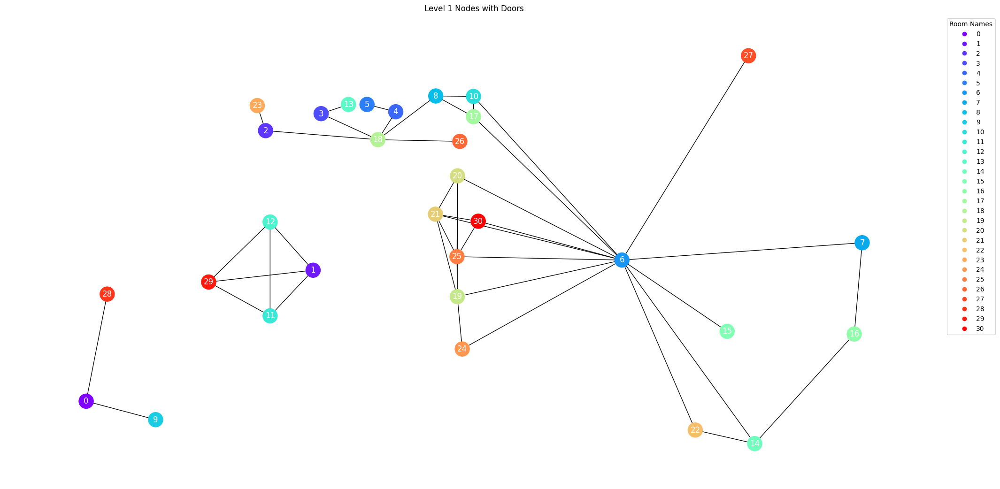

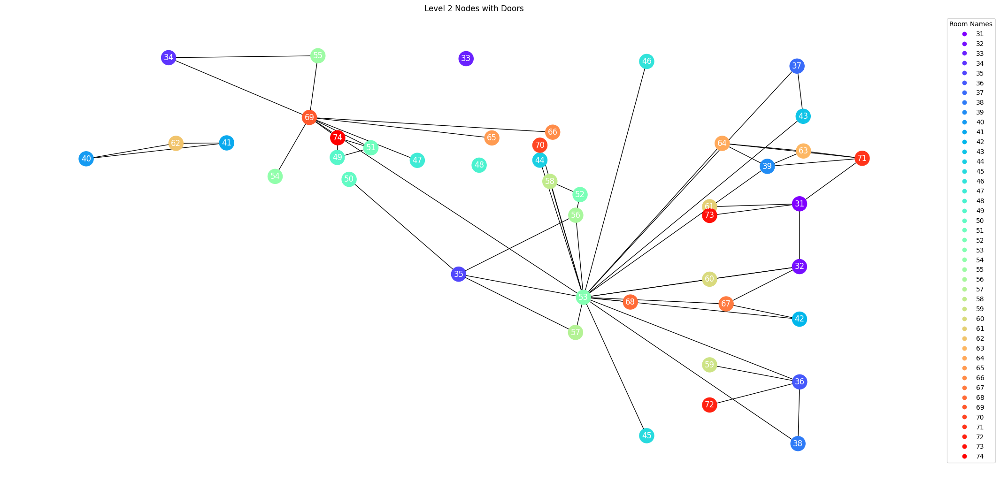

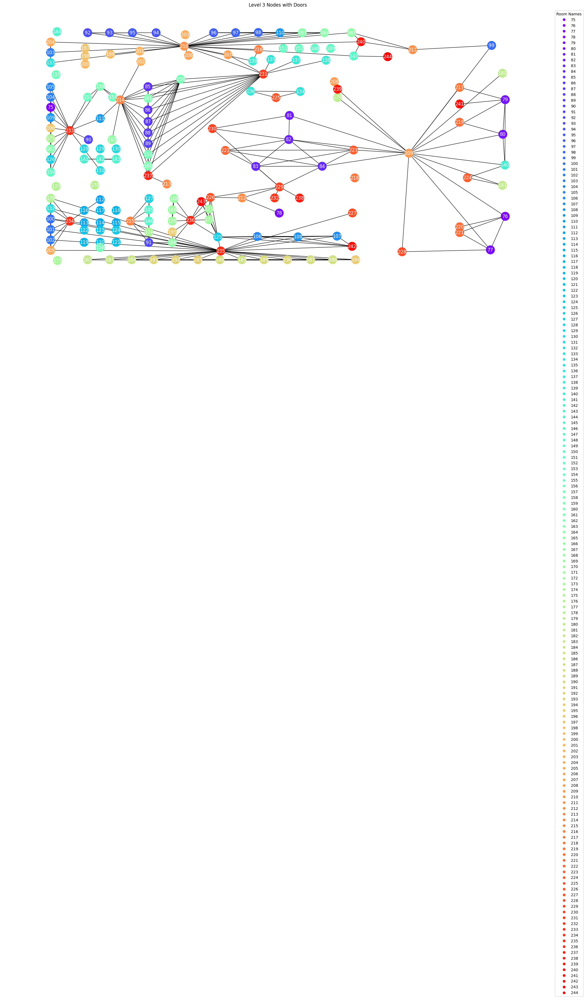

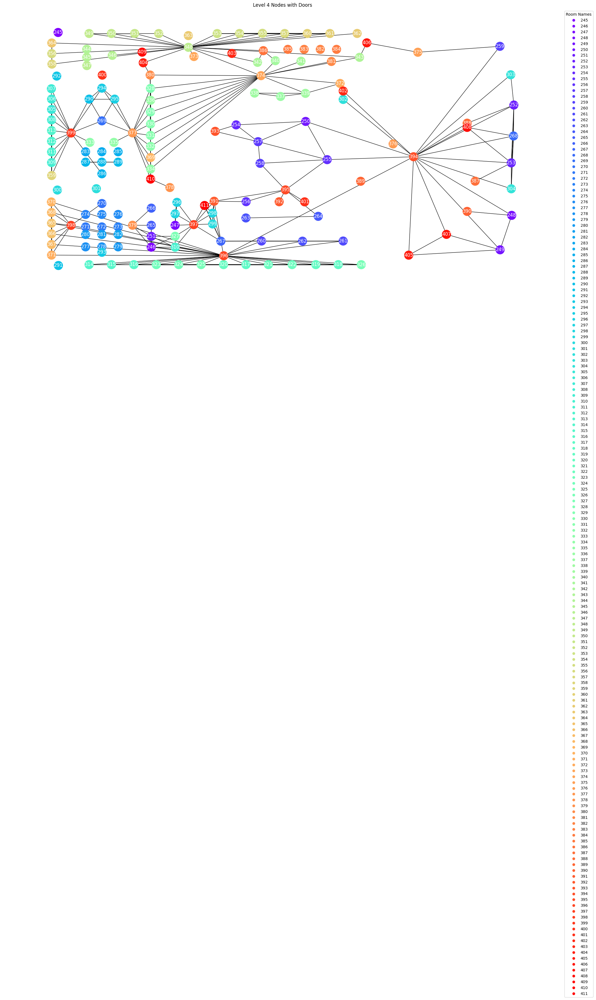

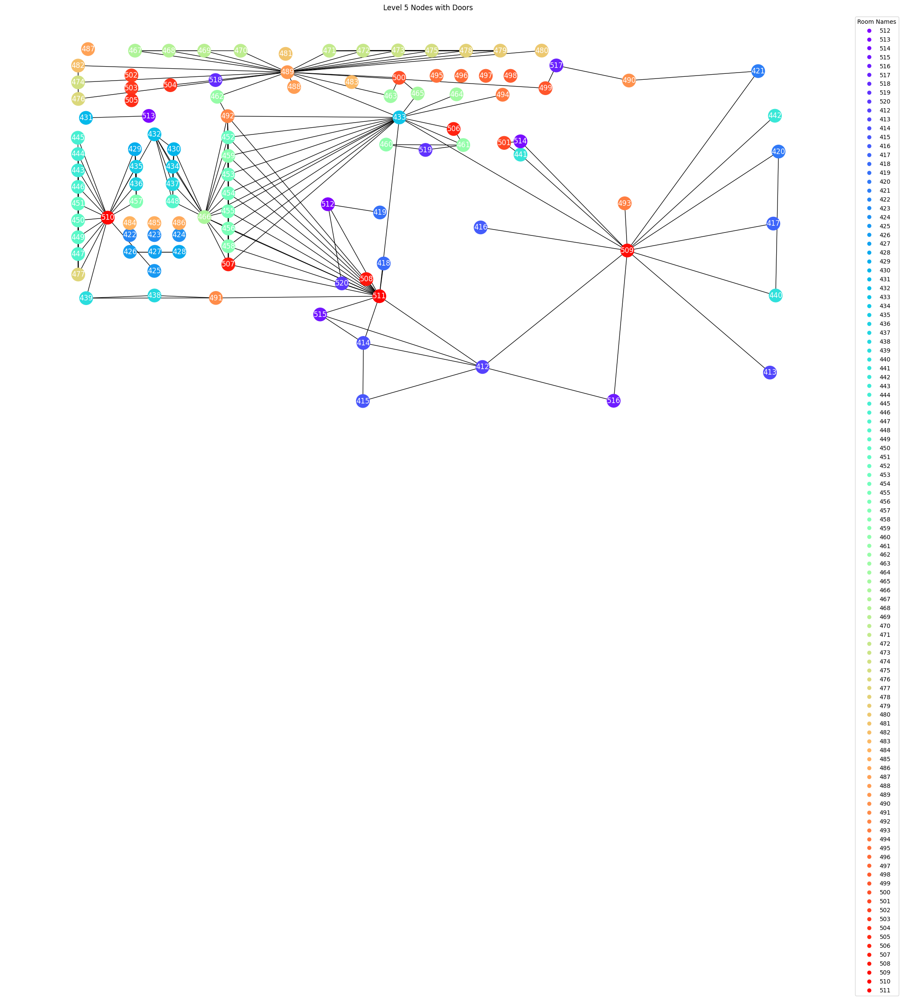

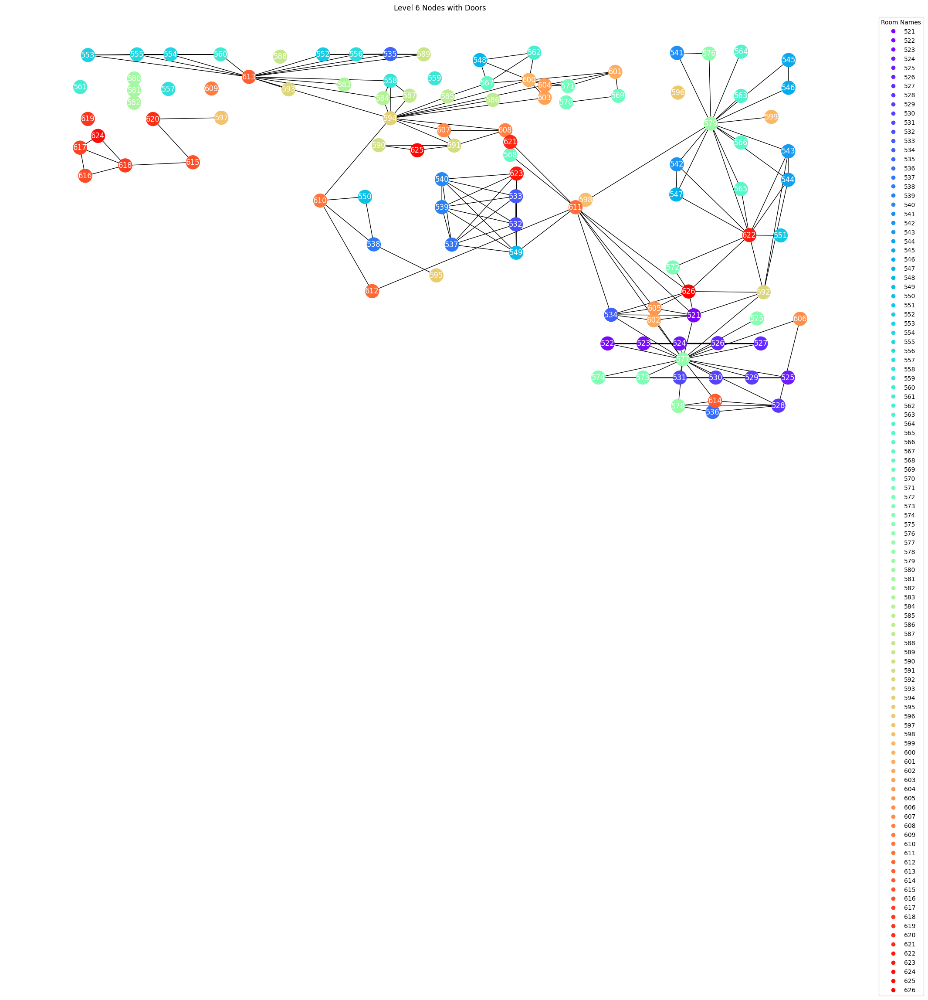

In [80]:
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import ast
import numpy as np

# Load Data
nodes_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_edgelist.csv")

# Filter edges that have a door
filtered_edges_df = edges_df[edges_df['Access'] == 1]

# Initialize empty graphs dictionary to store graphs for each level
graphs = {}

# Add Nodes and Edges to the corresponding graph based on 'Level'
for i, row in nodes_df.iterrows():
    level = row['Level']
    pos_tuple = ast.literal_eval(row['Centroid'])
    label = row['Room Name']

    if level not in graphs:
        graphs[level] = nx.Graph()

    graphs[level].add_node(i, pos=pos_tuple, label=label)

for i, row in filtered_edges_df.iterrows():
    vi, vj = row['vi'], row['vj']
    level = nodes_df.loc[nodes_df.index == vi, 'Level'].values[0]

    if level in graphs:
        graphs[level].add_edge(vi, vj)

# Plotting
for level, G in graphs.items():
    plt.figure(figsize=(20, 10))
    pos = {node: G.nodes[node]['pos'] for node in G.nodes}
    
    # Use the node index itself as the label
    labels = {node: node for node in G.nodes}

    unique_labels = list(set(labels.values()))
    colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_labels)))
    label_to_color = {label: colors[i] for i, label in enumerate(unique_labels)}
    node_colors = [label_to_color[labels[node]] for node in G.nodes]

    nx.draw(G, pos, with_labels=True, labels=labels, node_color=node_colors, font_color='white', node_size=500)

    proxy_rects = [plt.Line2D([0], [0], linestyle="none", color=label_to_color[label], marker='o') for label in unique_labels]
    plt.legend(proxy_rects, unique_labels, title="Room Names", numpoints=1, loc="upper left", bbox_to_anchor=(1, 1))

    plt.title(f'Level {level} Nodes with Doors')
    plt.show()


Enrich by room adj

In [83]:
import pandas as pd

# Read the touching_room_edges.csv and merged_nodes.csv files
touching_edges = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\touching_rooms_edges.csv")
merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")

# Filter out rows where Level contains "PENTHOUSE" or "LOWER LEVEL"
touching_edges = touching_edges[~touching_edges['Level'].str.contains('PENTHOUSE|LOWER LEVEL', case=False, na=False)]

# Step 1: Change 'Level' values to numerical format
extracted_levels = touching_edges['Level'].str.extract('(\d+)')
touching_edges['Level'] = extracted_levels.fillna(0).astype(int)

# Create mappings from Room Unique ID and Level to Index, Room Number, and Room Name
mapping = merged_nodes.set_index(['Room Unique ID', 'Level'])[['Index', 'Room Number', 'Room Name']].to_dict(orient='index')

# Initialize a list to hold the new rows for the new CSV
new_rows = []

# Step 2: Create new rows based on touching_room_edges.csv
for idx, row in touching_edges.iterrows():
    vi_info = mapping.get((row['Room Unique ID'], row['Level']))
    if vi_info is None:
        continue  # Skip if not found in merged_nodes.csv
    
    touching_rooms = row['Touching Rooms'].split(';')
    
    for room_number in touching_rooms:
        vj_info = merged_nodes.loc[(merged_nodes['Room Number'] == room_number) & (merged_nodes['Level'] == row['Level'])]
        if vj_info.empty:
            continue  # Skip if not found in merged_nodes.csv
        
        vj_info = vj_info.iloc[0].to_dict()
        
        new_row = {
            'vi': vi_info['Index'],
            'vi Room Number': row['Room Number'],
            'vi Room Name': row['Room Name'],
            'vi Room Unique ID': row['Room Unique ID'],
            'vj': vj_info['Index'],
            'vj Room Number': vj_info['Room Number'],
            'vj Room Name': vj_info['Room Name'],
            'vj Room Unique ID': vj_info['Room Unique ID'],
            'Access': 1  # Setting Access to 1 for all rows
        }
        
        new_rows.append(new_row)

# Create a DataFrame from the list of new rows
new_df = pd.DataFrame(new_rows)

# Save the new DataFrame to a new CSV file
new_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\room_to_room_edgelist.csv", index=False)


In [89]:
import pandas as pd

# Read the existing edgelists
merged_filtered_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_filtered_edgelist.csv")
room_to_room_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\room_to_room_edgelist.csv")

# Create sets of (vi, vj) tuples for each DataFrame
merged_filtered_edges_set = set(zip(merged_filtered_edgelist['vi'], merged_filtered_edgelist['vj']))
room_to_room_edges_set = set(zip(room_to_room_edgelist['vi'], room_to_room_edgelist['vj']))

# Find the intersection of the two sets to identify duplicate edges
duplicate_edges = merged_filtered_edges_set.intersection(room_to_room_edges_set)

# Output the duplicate edges
if len(duplicate_edges) > 0:
    print(f"There are {len(duplicate_edges)} duplicate edges. Here are some examples:")
    print(list(duplicate_edges)[:10])  # Print up to 10 examples

    # Save the duplicate edges to a CSV
    duplicate_df = pd.DataFrame(list(duplicate_edges), columns=['vi', 'vj'])
    duplicate_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\duplicate_edges.csv", index=False)
else:
    print("No duplicate edges found.")


There are 1100 duplicate edges. Here are some examples:
[(534, 577), (185, 194), (444, 445), (36, 53), (18, 26), (306, 313), (318, 324), (104, 233), (109, 150), (8, 18)]


In [6]:
import pandas as pd

# Read the existing edgelists
merged_filtered_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_filtered_edgelist.csv")
room_to_room_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\room_to_room_edgelist.csv")

# Create sets of (vi, vj) tuples for each DataFrame
merged_filtered_edges_set = set(zip(merged_filtered_edgelist['vi'], merged_filtered_edgelist['vj']))
room_to_room_edges_set = set(zip(room_to_room_edgelist['vi'], room_to_room_edgelist['vj']))

# Find unique edges from room_to_room_edgelist by subtracting the duplicate edges
unique_room_to_room_edges = room_to_room_edges_set - merged_filtered_edges_set

# Filter the room_to_room_edgelist DataFrame to only include these unique edges
unique_room_to_room_df = room_to_room_edgelist[room_to_room_edgelist.set_index(['vi', 'vj']).index.isin(unique_room_to_room_edges)]

# Fill in "[]" for the Wall Footprint column for these new edges
unique_room_to_room_df['Wall Footprint'] = '[]'

# Concatenate the merged_filtered_edgelist and the unique edges from room_to_room_edgelist
new_filtered_merge_edgelist = pd.concat([merged_filtered_edgelist, unique_room_to_room_df], ignore_index=True)

# Save the resulting DataFrame to a new CSV file
new_filtered_merge_edgelist.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv", index=False)


C:\Users\Georgios Bekakos\AppData\Local\Temp\ipykernel_41008\2274163237.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unique_room_to_room_df['Wall Footprint'] = '[]'


In [7]:
import pandas as pd

# Read the existing edgelist
edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")

# Filter the DataFrame to find rows where 'vi Room Unique ID' is equal to 'vj Room Unique ID'
self_connected_rows = edgelist[edgelist['vi Room Unique ID'] == edgelist['vj Room Unique ID']]

# Print the count of self-connected rows
print(f"There are {len(self_connected_rows)} rows where 'vi Room Unique ID' is the same as 'vj Room Unique ID'.")

# Remove these rows from the DataFrame
edgelist = edgelist[edgelist['vi Room Unique ID'] != edgelist['vj Room Unique ID']]

# Save the filtered edgelist back to a CSV file
edgelist.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv", index=False)


There are 72 rows where 'vi Room Unique ID' is the same as 'vj Room Unique ID'.


custom addup - design errors

In [48]:
import pandas as pd

# Read the existing edgelist and nodes CSV files
edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")

# Define the new connections
new_connections = [
    (1, 24), (19, 25), (20, 25), 
    (29, 28), (29, 9), (0, 9), 
    (9, 28), (23, 29), (40, 66), (54, 66),
    (597, 594), (613, 620), (1, 26), (1, 20), (1, 6)
]

# Initialize an empty list to store the new edges
new_edges = []

# Populate the new_edges list with the corresponding node information
for vi, vj in new_connections:
    vi_info = nodes.loc[nodes['Index'] == vi].iloc[0].to_dict()
    vj_info = nodes.loc[nodes['Index'] == vj].iloc[0].to_dict()
    
    new_edge = {
        'vi': vi,
        'vi Room Number': vi_info['Room Number'],
        'vi Room Name': vi_info['Room Name'],
        'vi Room Unique ID': vi_info['Room Unique ID'],
        'vj': vj,
        'vj Room Number': vj_info['Room Number'],
        'vj Room Name': vj_info['Room Name'],
        'vj Room Unique ID': vj_info['Room Unique ID'],
        'Access': 1,
        'Wall Footprint': '[]'
    }
    
    new_edges.append(new_edge)

# Create a DataFrame for the new edges
new_edges_df = pd.DataFrame(new_edges)

# Append the new edges to the existing edgelist
updated_edgelist = pd.concat([edgelist, new_edges_df], ignore_index=True)

# Save the updated edgelist to the same CSV file
updated_edgelist.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv", index=False)


In [32]:
import pandas as pd

# Read the merged_vertical_edgelist.csv file from the Desktop
vertical_edgelist_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Add a new 'Access' column with value 1
vertical_edgelist_df['Access'] = 1

# Save the DataFrame back to a new CSV file on the Desktop
vertical_edgelist_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv", index=False)


new plots

In [33]:
print(edges_df['Access'].unique())

[1]


In [56]:
import pandas as pd

# Load the DataFrame
edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")

# Create a new column with (vi, vj) as a tuple
edges_df['vi_vj_tuple'] = edges_df.apply(lambda row: (row['vi'], row['vj']), axis=1)

# Identify exactly duplicated rows based on vi_vj_tuple
exact_duplicates = edges_df[edges_df.duplicated(subset=['vi_vj_tuple'], keep=False)]

# Create a new column that contains tuples of (vi, vj) sorted, so (vi, vj) and (vj, vi) become identical
edges_df['sorted_tuple'] = edges_df.apply(lambda row: tuple(sorted((row['vi'], row['vj']))), axis=1)

# Identify duplicates where (vi, vj) and (vj, vi) are considered the same
swapped_duplicates = edges_df[edges_df.duplicated(subset=['sorted_tuple'], keep=False)]

# Count the number of each type of duplicate
num_exact_duplicates = len(exact_duplicates)
num_swapped_duplicates = len(swapped_duplicates) // 2  # Each pair is counted twice

print(f"The number of exactly duplicate rows is: {num_exact_duplicates}")
print(f"The number of duplicate edge pairs considering swapped values is: {num_swapped_duplicates}")

# Filter out the duplicates
filtered_df = edges_df.drop_duplicates(subset=['sorted_tuple'])

# Remove the extra columns
filtered_df.drop(['vi_vj_tuple', 'sorted_tuple'], axis=1, inplace=True)

# Save the updated DataFrame
filtered_df.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\updated_new_filtered_merge_edgelist.csv", index=False)


The number of exactly duplicate rows is: 78
The number of duplicate edge pairs considering swapped values is: 1133


C:\Users\Georgios Bekakos\AppData\Local\Temp\ipykernel_40020\2552208342.py:29: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



NETWORKS

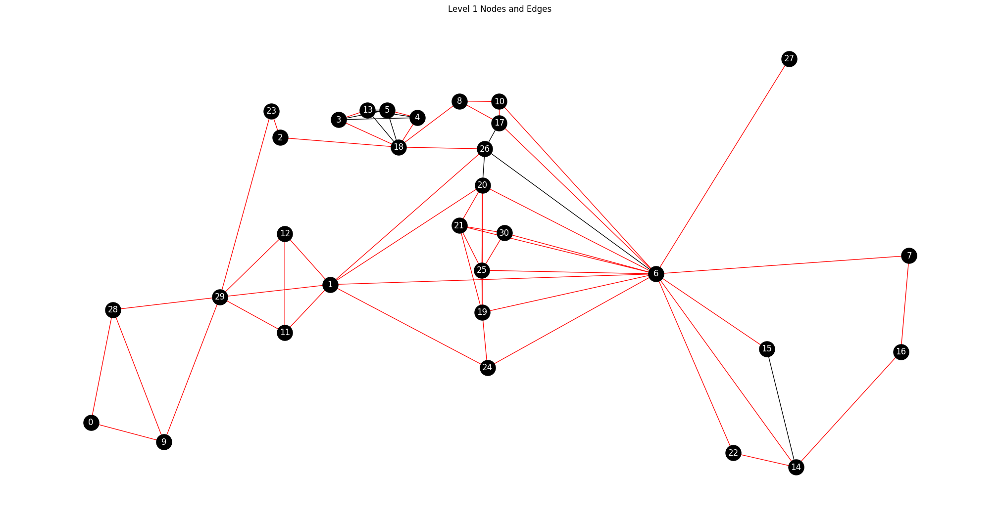

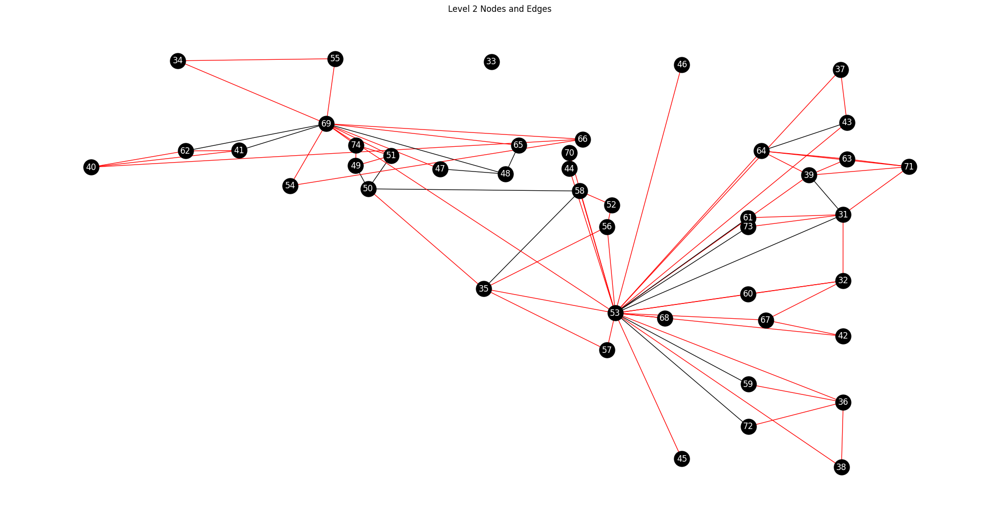

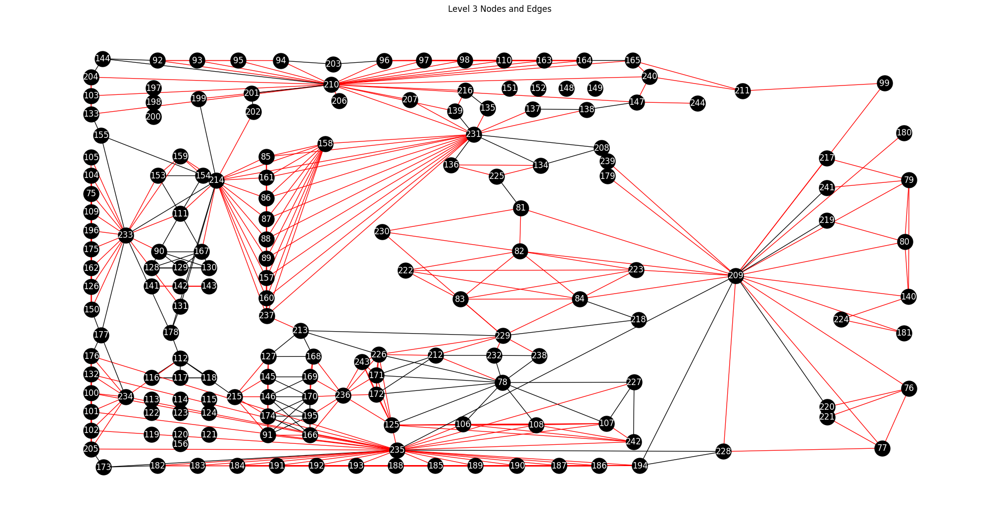

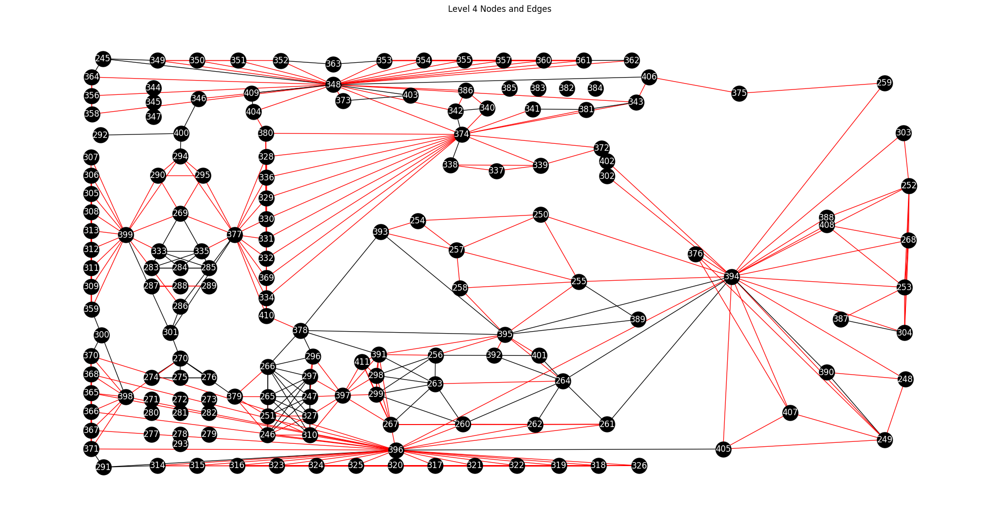

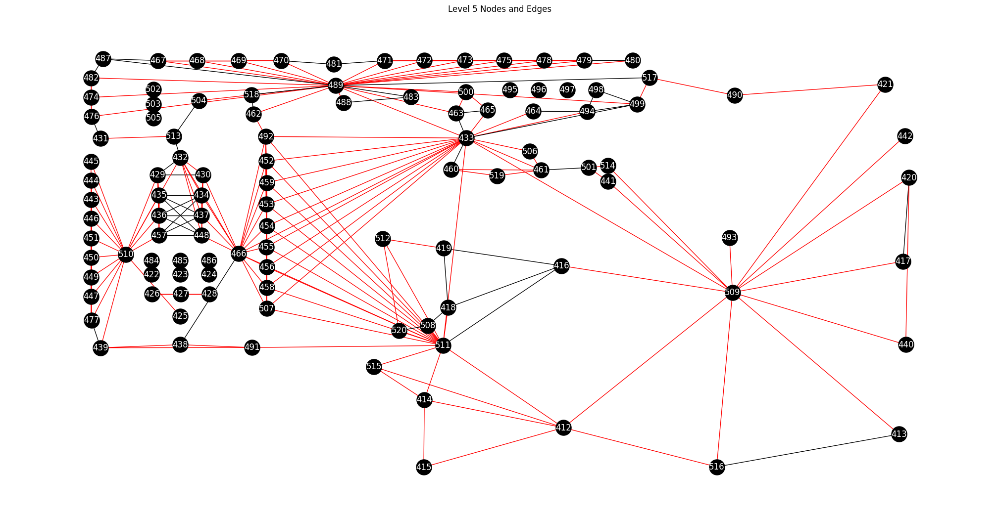

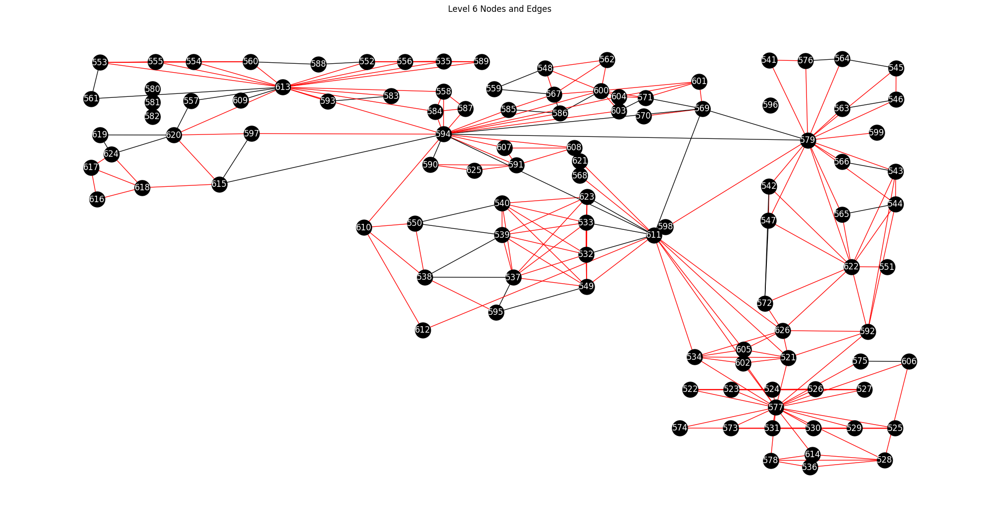

In [77]:
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import ast
import numpy as np

# Load Data
nodes_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")

# Initialize empty graphs dictionary to store graphs for each level
graphs = {}

# Add Nodes and Edges to the corresponding graph based on 'Level'
for i, row in nodes_df.iterrows():
    level = row['Level']
    pos_tuple = ast.literal_eval(row['Centroid'])
    label = row['Room Name']

    if level not in graphs:
        graphs[level] = nx.Graph()

    graphs[level].add_node(i, pos=pos_tuple, label=label)

for i, row in edges_df.iterrows():
    vi, vj = row['vi'], row['vj']
    access = row['Access']
    level = nodes_df.loc[nodes_df.index == vi, 'Level'].values[0]

    if level in graphs:
        graphs[level].add_edge(vi, vj, Access=access)

# Plotting
for level, G in graphs.items():
    plt.figure(figsize=(20, 10))
    pos = {node: G.nodes[node]['pos'] for node in G.nodes}
    
    # Use the node index itself as the label
    labels = {node: node for node in G.nodes}

    edge_colors = ['red' if G[vi][vj]['Access'] == 1 else 'black' for vi, vj in G.edges]

    nx.draw(G, pos, with_labels=True, labels=labels, edge_color=edge_colors, node_color='black', font_color='white', node_size=500)

    plt.title(f'Level {level} Nodes and Edges')
    plt.show()


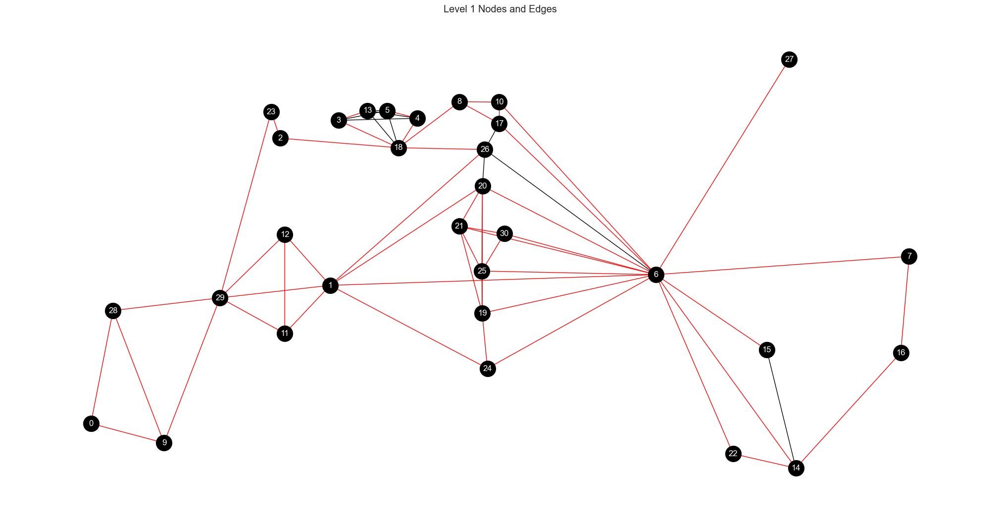

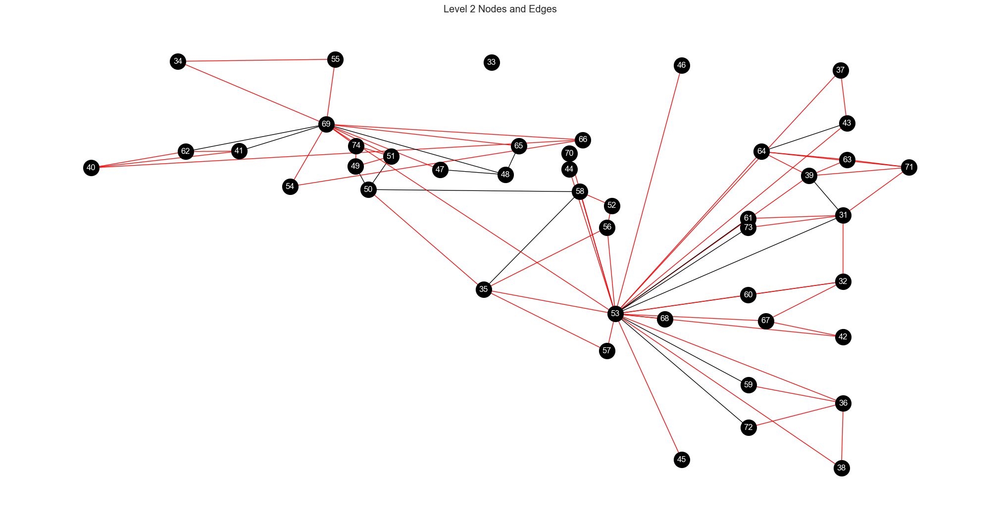

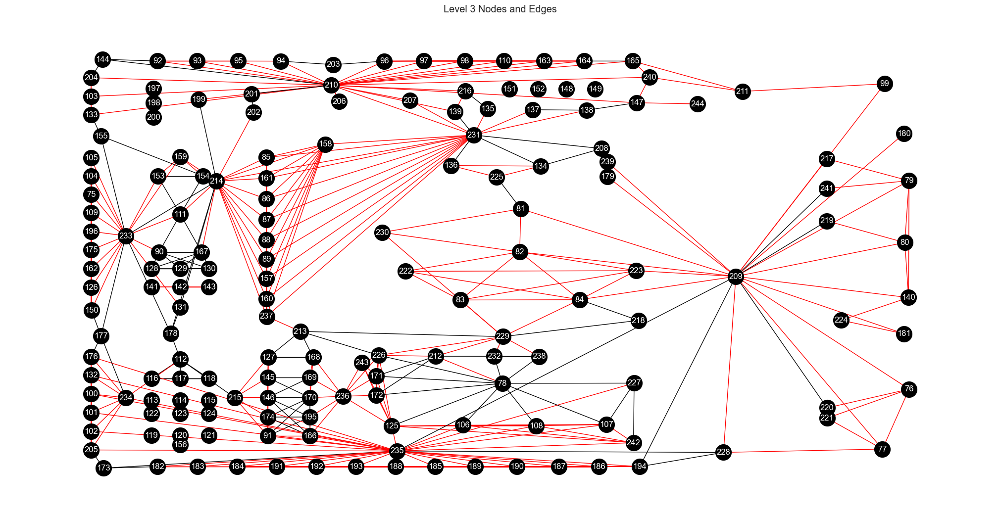

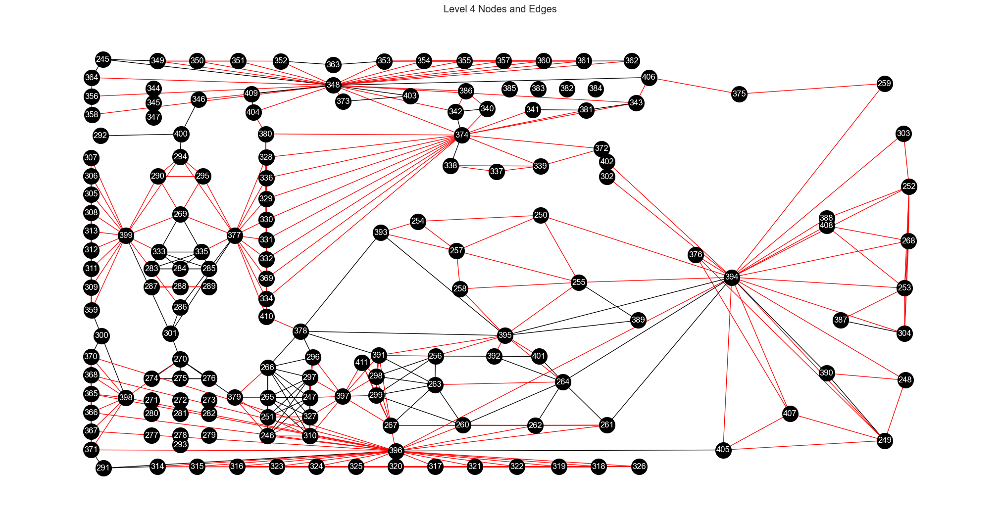

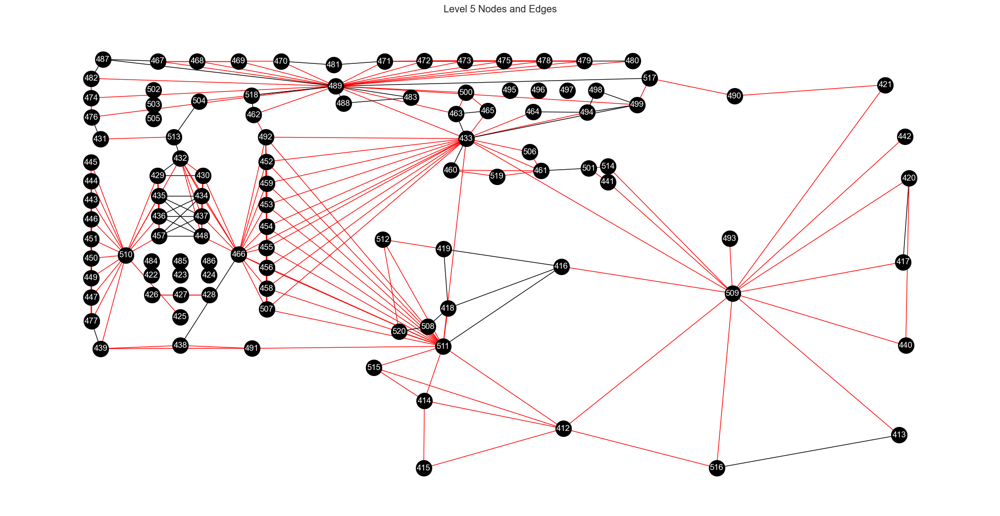

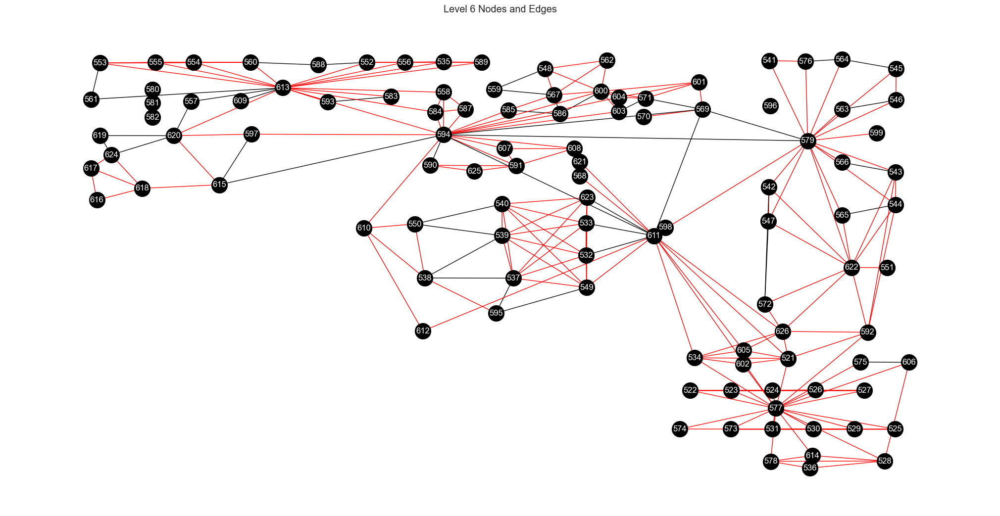

In [83]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import ast
import numpy as np

# Set Seaborn styles
sns.set(style="whitegrid")

# Load Data
nodes_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")

# Initialize empty graphs dictionary to store graphs for each level
graphs = {}

# Add Nodes and Edges to the corresponding graph based on 'Level'
for i, row in nodes_df.iterrows():
    level = row['Level']
    pos_tuple = ast.literal_eval(row['Centroid'])
    label = row['Room Name']

    if level not in graphs:
        graphs[level] = nx.Graph()

    graphs[level].add_node(i, pos=pos_tuple, label=label)

for i, row in edges_df.iterrows():
    vi, vj = row['vi'], row['vj']
    access = row['Access']
    level = nodes_df.loc[nodes_df.index == vi, 'Level'].values[0]

    if level in graphs:
        graphs[level].add_edge(vi, vj, Access=access)

# Plotting
for level, G in graphs.items():
    plt.figure(figsize=(20, 10))
    
    # Use Seaborn to set figure aesthetics
    sns.set_context("talk", font_scale=0.8)
    
    pos = {node: G.nodes[node]['pos'] for node in G.nodes}
    
    # Use the node index itself as the label
    labels = {node: node for node in G.nodes}

    edge_colors = ['red' if G[vi][vj]['Access'] == 1 else 'black' for vi, vj in G.edges]

    nx.draw(G, pos, with_labels=True, labels=labels, edge_color=edge_colors, node_color='black', font_color='white', node_size=500)

    plt.title(f'Level {level} Nodes and Edges')
    plt.show()


In [67]:
import pandas as pd
import networkx as nx
import plotly.graph_objects as go
import ast

# Load data
nodes_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
vertical_edges_df = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Initialize graph
G = nx.Graph()

# Create a color map
unique_room_names = nodes_df['Room Name'].unique()
color_list = ['red', 'blue', 'green', 'yellow', 'purple', 'orange']
color_map = {name: color_list[i % len(color_list)] for i, name in enumerate(unique_room_names)}

# Add nodes
for i, row in nodes_df.iterrows():
    xy = ast.literal_eval(row['Centroid'])
    z = row['Level'] * 10  # Adjust level scaling as needed
    G.add_node(row['Index'], pos=(xy[0], xy[1], z), **row.to_dict())

# Add horizontal edges
for i, row in edges_df.iterrows():
    G.add_edge(row['vi'], row['vj'], Access=row['Access'])

# Add vertical edges
for i, row in vertical_edges_df.iterrows():
    G.add_edge(row['vi'], row['vj'], Access=1)  # Assuming all vertical connections have Access = 1

# 3D plot
node_x, node_y, node_z = [], [], []
node_color = []
edge_x, edge_y, edge_z = [], [], []

# Extract node information
for node in G.nodes():
    x, y, z = G.nodes[node]['pos']
    node_x.append(x)
    node_y.append(y)
    node_z.append(z)
    node_color.append(color_map.get(G.nodes[node]['Room Name'], 'grey'))

# Extract edge information
for edge in G.edges():
    x0, y0, z0 = G.nodes[edge[0]]['pos']
    x1, y1, z1 = G.nodes[edge[1]]['pos']
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_z.extend([z0, z1, None])

# Create the 3D Plot
edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', line=dict(width=3, color='black'))
node_trace = go.Scatter3d(x=node_x, y=node_y, z=node_z, mode='markers', marker=dict(size=8, color=node_color))

layout = go.Layout(scene=dict(xaxis=dict(nticks=4, range=[min(node_x), max(node_x)]),
                              yaxis=dict(nticks=4, range=[min(node_y), max(node_y)]),
                              zaxis=dict(nticks=4, range=[min(node_z), max(node_z)])))

fig = go.Figure(data=[edge_trace, node_trace], layout=layout)
fig.show()


In [72]:
import pandas as pd
import networkx as nx
import plotly.graph_objects as go

# Read the existing edgelist and nodes CSV files
edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Create a NetworkX graph
G = nx.Graph()

# Add nodes
for index, row in nodes.iterrows():
    G.add_node(row['Index'], **row.to_dict())

# Add edges from the edgelist
for index, row in edgelist.iterrows():
    G.add_edge(row['vi'], row['vj'], **row.to_dict())

# Add vertical edges from the vertical edgelist
for index, row in vertical_edgelist.iterrows():
    G.add_edge(row['vi'], row['vj'], **row.to_dict())

# Initialize lists for 3D plotting
edge_x, edge_y, edge_z = [], [], []
unique_room_names = nodes['Room Name'].unique()
color_map = {room: index for index, room in enumerate(unique_room_names)}

traces = []  # Initialize traces list to collect node traces

# Populate edge lists for plotting
for edge in G.edges():
    x0, y0 = G.nodes[edge[0]]['Centroid'].strip('()').split(',')
    x1, y1 = G.nodes[edge[1]]['Centroid'].strip('()').split(',')
    z0 = G.nodes[edge[0]]['Level']
    z1 = G.nodes[edge[1]]['Level']

    edge_x.extend([float(x0), float(x1), None])
    edge_y.extend([float(y0), float(y1), None])
    edge_z.extend([float(z0), float(z1), None])

# Create scatter plot for each room type
for room in unique_room_names:
    node_x, node_y, node_z = [], [], []

    for node in G.nodes():
        if G.degree[node] > 0 and G.nodes[node]['Room Name'] == room:
            x, y = G.nodes[node]['Centroid'].strip('()').split(',')
            z = G.nodes[node]['Level']
            node_x.append(float(x))
            node_y.append(float(y))
            node_z.append(float(z))

    trace = go.Scatter3d(x=node_x, y=node_y, z=node_z, mode='markers',
                         marker=dict(size=8, color=color_map[room]),
                         name=room)
    traces.append(trace)

# Add edges to the plot
edge_trace = go.Scatter3d(x=edge_x, y=edge_y, z=edge_z, mode='lines', line=dict(width=3, color='black'))

# Create Plot
layout = go.Layout(scene=dict(xaxis=dict(nticks=4),
                              yaxis=dict(nticks=4),
                              zaxis=dict(nticks=4)),
                   showlegend=True)

traces.append(edge_trace)
fig = go.Figure(data=traces, layout=layout)
fig.show(renderer='browser')


NETWORKX functions

minimum spanning tree

In [73]:
import pandas as pd
import networkx as nx
import plotly.graph_objects as go

# Read the existing edgelist and nodes CSV files
edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Create a NetworkX graph and its Minimum Spanning Tree
G = nx.Graph()

# Add nodes
for index, row in nodes.iterrows():
    G.add_node(row['Index'], **row.to_dict())

# Add edges from the edgelist
for index, row in edgelist.iterrows():
    G.add_edge(row['vi'], row['vj'], **row.to_dict())

# Compute the Minimum Spanning Tree
MST = nx.minimum_spanning_tree(G)

# Initialize lists for 3D plotting
mst_edge_x, mst_edge_y, mst_edge_z = [], [], []
unique_room_names = nodes['Room Name'].unique()
color_map = {room: index for index, room in enumerate(unique_room_names)}

mst_traces = []  # Initialize traces list to collect node traces

# Populate MST edge lists for plotting
for edge in MST.edges():
    x0, y0 = MST.nodes[edge[0]]['Centroid'].strip('()').split(',')
    x1, y1 = MST.nodes[edge[1]]['Centroid'].strip('()').split(',')
    z0 = MST.nodes[edge[0]]['Level']
    z1 = MST.nodes[edge[1]]['Level']

    mst_edge_x.extend([float(x0), float(x1), None])
    mst_edge_y.extend([float(y0), float(y1), None])
    mst_edge_z.extend([float(z0), float(z1), None])

# Create scatter plot for each room type in MST
for room in unique_room_names:
    node_x, node_y, node_z = [], [], []

    for node in MST.nodes():
        if MST.degree[node] > 0 and MST.nodes[node]['Room Name'] == room:
            x, y = MST.nodes[node]['Centroid'].strip('()').split(',')
            z = MST.nodes[node]['Level']
            node_x.append(float(x))
            node_y.append(float(y))
            node_z.append(float(z))

    trace = go.Scatter3d(x=node_x, y=node_y, z=node_z, mode='markers',
                         marker=dict(size=8, color=color_map[room]),
                         name=room)
    mst_traces.append(trace)

# Add MST edges to the plot
mst_edge_trace = go.Scatter3d(x=mst_edge_x, y=mst_edge_y, z=mst_edge_z, mode='lines', line=dict(width=3, color='red'))

# Create Plot for MST
layout = go.Layout(scene=dict(xaxis=dict(nticks=4),
                              yaxis=dict(nticks=4),
                              zaxis=dict(nticks=4)),
                   showlegend=True)

mst_traces.append(mst_edge_trace)
fig = go.Figure(data=mst_traces, layout=layout)
fig.show(renderer='browser')


centralities

In [80]:
import pandas as pd
import networkx as nx

# Read the existing nodes and edgelist CSV files
nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_nodes.csv")
edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")

# Create a NetworkX graph
G = nx.Graph()

# Add nodes
for index, row in nodes.iterrows():
    G.add_node(row['Index'], **row.to_dict())

# Add edges from the edgelist
for index, row in edgelist.iterrows():
    G.add_edge(row['vi'], row['vj'], **row.to_dict())

# Compute various network metrics
degree_centrality = nx.degree_centrality(G)
closeness_centrality = nx.closeness_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G)
pagerank = nx.pagerank(G)

# Additional metrics
clustering = nx.clustering(G)
core_number = nx.core_number(G)

# Create lists to hold metric values
degree_centrality_list = []
closeness_centrality_list = []
betweenness_centrality_list = []
pagerank_list = []
clustering_list = []
core_number_list = []

# Map metrics to DataFrame
for index, row in nodes.iterrows():
    node = row['Index']
    degree_centrality_list.append(degree_centrality.get(node, 0))
    closeness_centrality_list.append(closeness_centrality.get(node, 0))
    betweenness_centrality_list.append(betweenness_centrality.get(node, 0))
    pagerank_list.append(pagerank.get(node, 0))
    clustering_list.append(clustering.get(node, 0))
    core_number_list.append(core_number.get(node, 0))

# Add new columns to DataFrame
nodes['Degree Centrality'] = degree_centrality_list
nodes['Closeness Centrality'] = closeness_centrality_list
nodes['Betweenness Centrality'] = betweenness_centrality_list
nodes['PageRank'] = pagerank_list
nodes['Clustering'] = clustering_list
nodes['Core Number'] = core_number_list

# Saving the enriched DataFrame as a new CSV file
nodes.to_csv("C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv", index=False)


PLOTS sns

In [85]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from pandas.plotting import parallel_coordinates
import networkx as nx

# Replace these paths with the paths to your CSV files on your Desktop
path_to_graph_merged_nodes = "C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv"
path_to_new_filtered_merge_edgelist = "C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv"

graph_merged_nodes = pd.read_csv(path_to_graph_merged_nodes)
new_filtered_merge_edgelist = pd.read_csv(path_to_new_filtered_merge_edgelist)


C:\Users\Georgios Bekakos\AppData\Roaming\Python\Python310\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



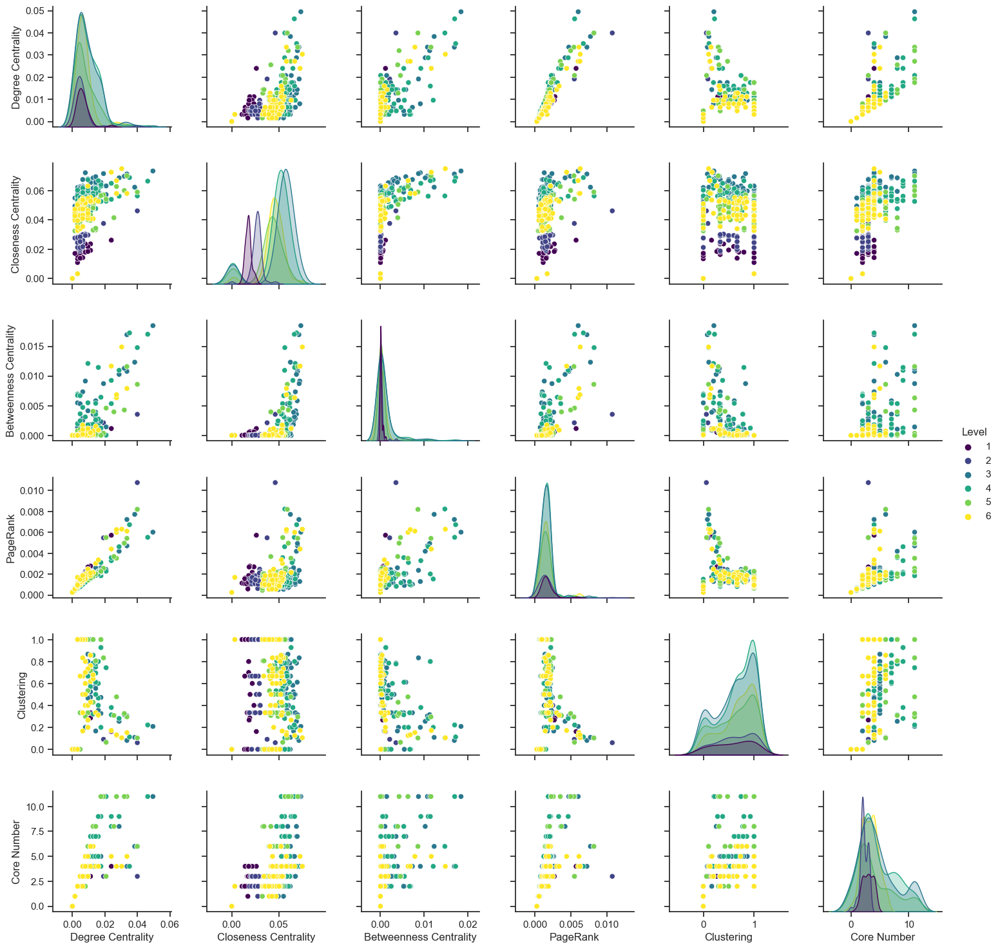

C:\Users\Georgios Bekakos\AppData\Local\Temp\ipykernel_40020\3137816791.py:40: MatplotlibDeprecationWarning:

The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.



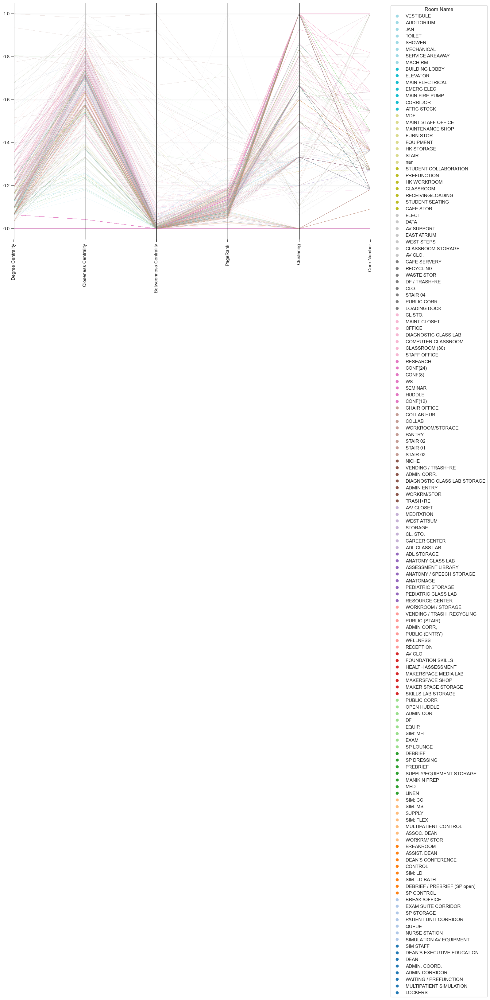

C:\Users\Georgios Bekakos\AppData\Local\Temp\ipykernel_40020\3137816791.py:54: MatplotlibDeprecationWarning:

The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.



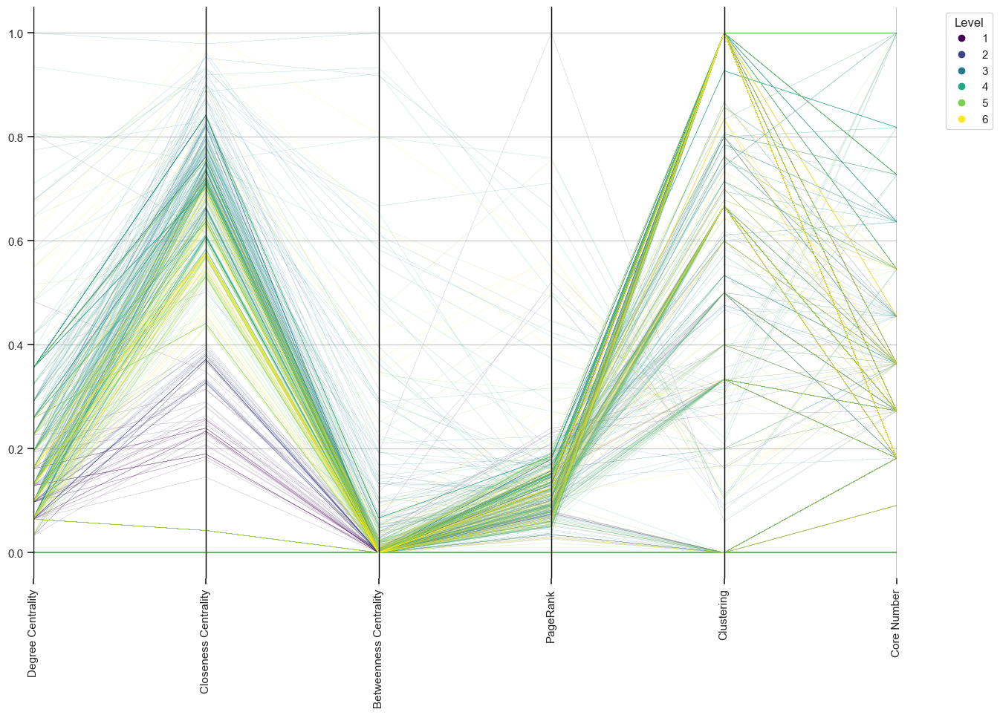

In [92]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from pandas.plotting import parallel_coordinates
import numpy as np
import networkx as nx

# Read your data
graph_merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv")
new_filtered_merge_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
merged_vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Network stats columns
network_stats_columns = ['Degree Centrality', 'Closeness Centrality', 'Betweenness Centrality', 'PageRank', 'Clustering', 'Core Number']

# Normalize the data
scaler = MinMaxScaler()
network_stats_df = graph_merged_nodes[network_stats_columns]
network_stats_normalized = pd.DataFrame(scaler.fit_transform(network_stats_df), columns=network_stats_columns)
network_stats_normalized['Room Name'] = graph_merged_nodes['Room Name']
network_stats_normalized['Level'] = graph_merged_nodes['Level'].astype('category')

# Pair Plot
sns.set(style="ticks")
sns.pairplot(graph_merged_nodes, vars=network_stats_columns, hue='Level', palette='viridis')
plt.yticks(rotation=0)
plt.subplots_adjust(wspace=0.3, hspace=0.3)
plt.show()

# Parallel Coordinates Plot (Room Name)
plt.figure(figsize=(15, 10), frameon=False)
cmap = plt.get_cmap('tab20_r')
colors = cmap(np.linspace(0, 1, len(network_stats_normalized['Room Name'].unique())))
pc = parallel_coordinates(network_stats_normalized, class_column='Room Name', cols=network_stats_columns, color=colors, linewidth=0.1)
for spine in plt.gca().spines.values():
    spine.set_visible(False)
plt.xticks(rotation='vertical')
legend = plt.legend(title='Room Name', bbox_to_anchor=(1.05, 1), loc='upper left')
for handle in legend.legendHandles:
    handle.set_linestyle("")
    handle.set_marker('o')
plt.show()

# Parallel Coordinates Plot (Level)
plt.figure(figsize=(15, 10), frameon=False)
cmap = plt.get_cmap('viridis')
colors = cmap(np.linspace(0, 1, len(network_stats_normalized['Level'].unique())))
pc = parallel_coordinates(network_stats_normalized, class_column='Level', cols=network_stats_columns, color=colors, linewidth=0.1)
for spine in plt.gca().spines.values():
    spine.set_visible(False)
plt.xticks(rotation='vertical')
legend = plt.legend(title='Level', bbox_to_anchor=(1.05, 1), loc='upper left')
for handle in legend.legendHandles:
    handle.set_linestyle("")
    handle.set_marker('o')
plt.show()


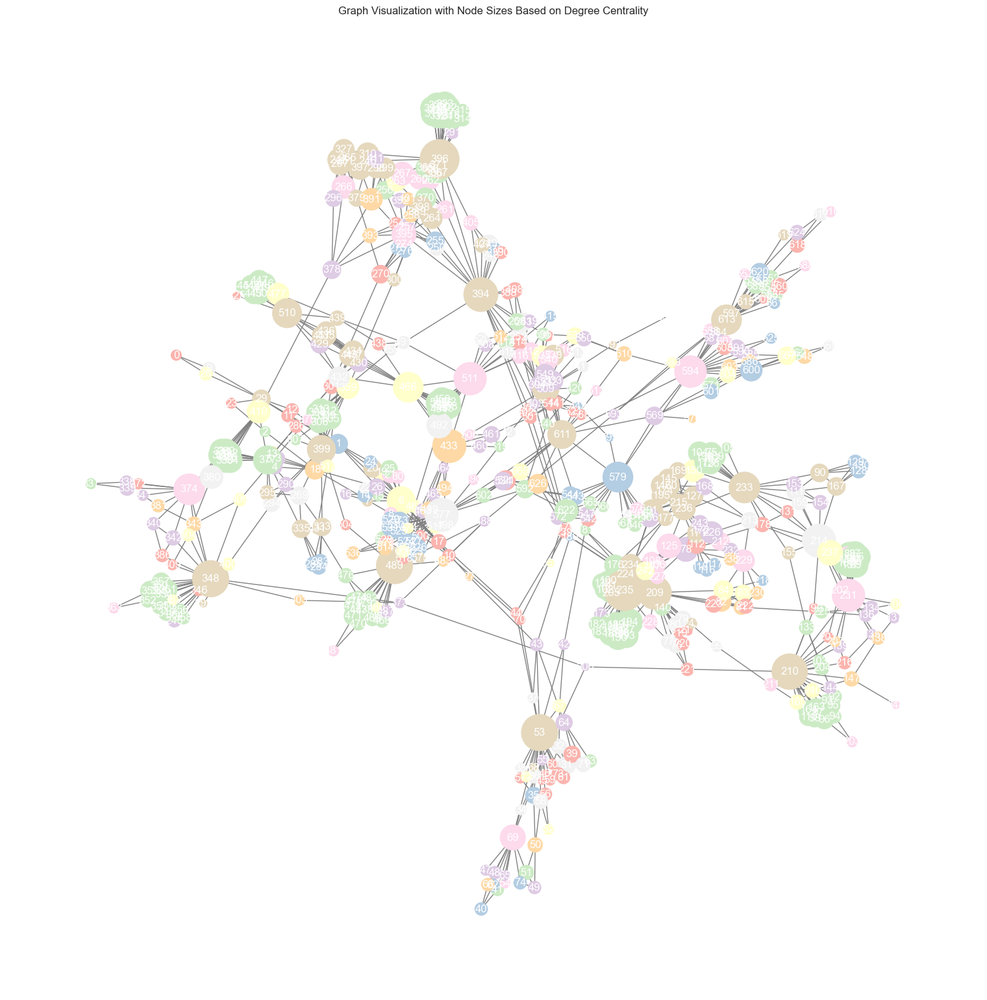

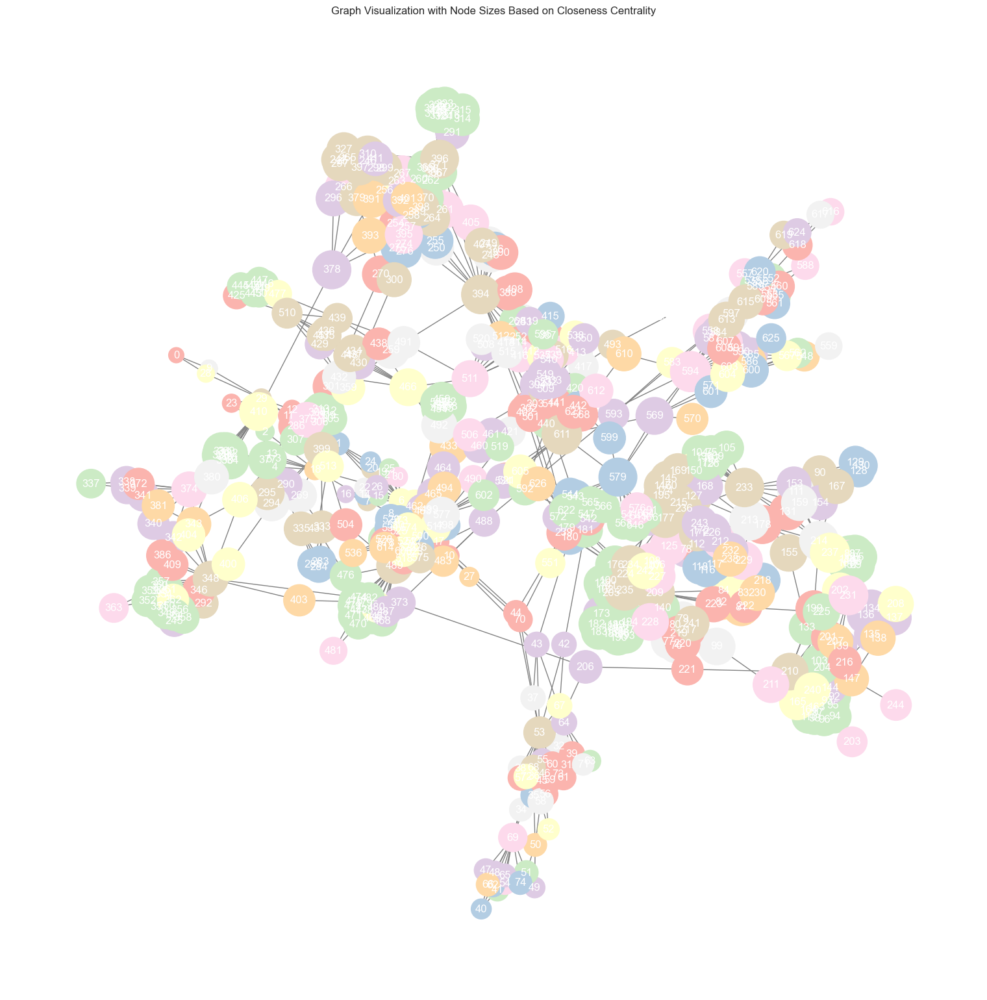

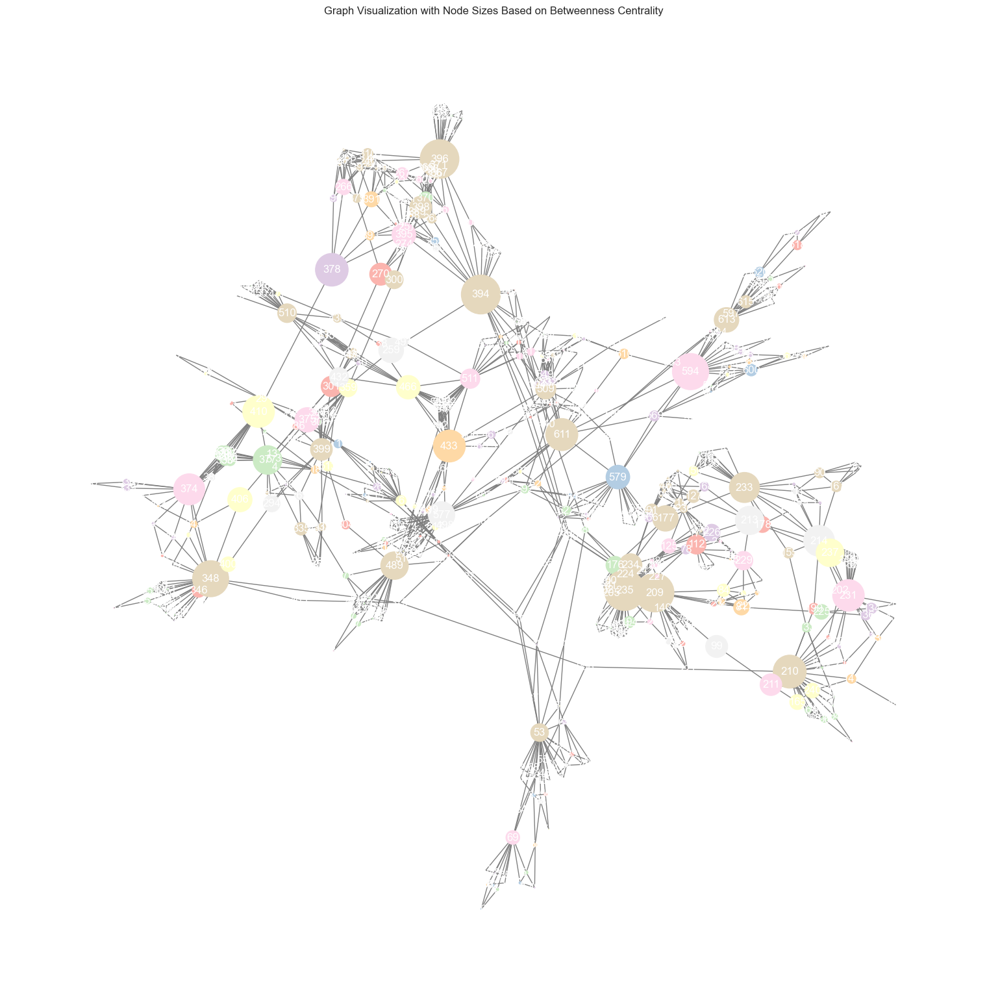

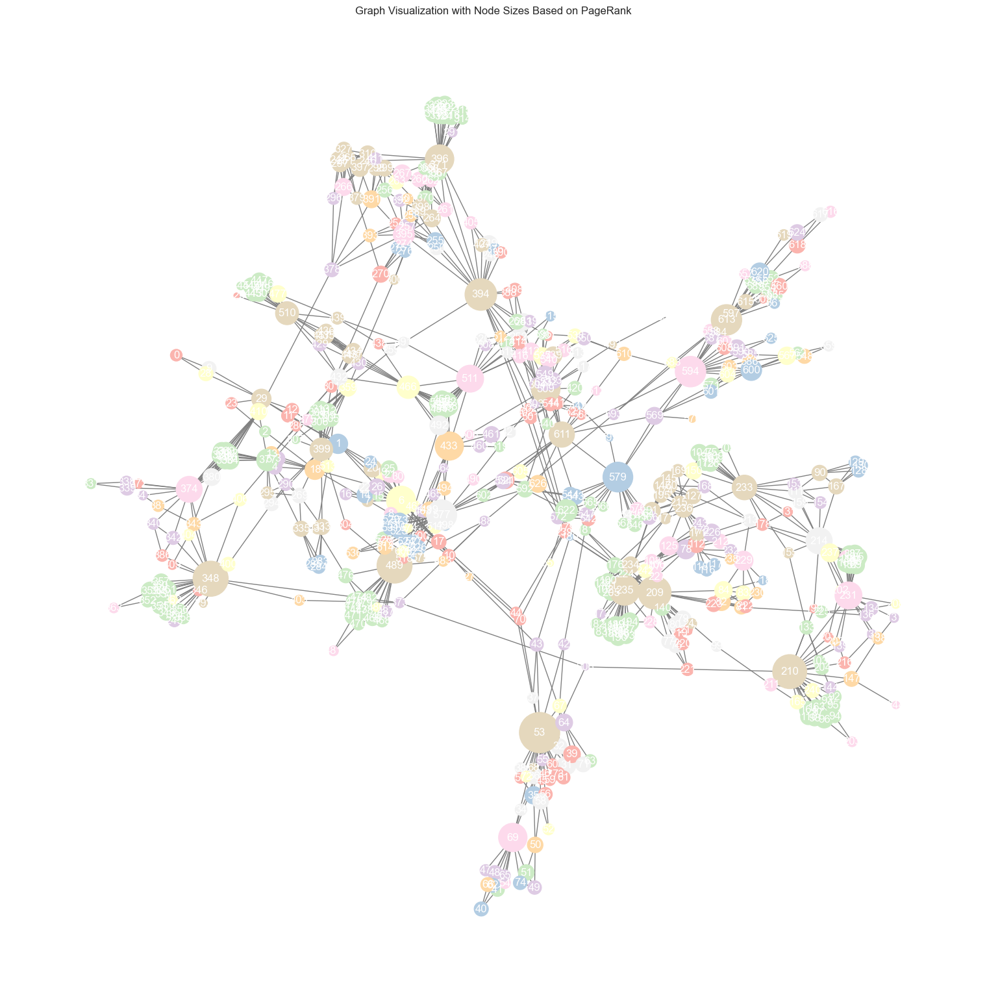

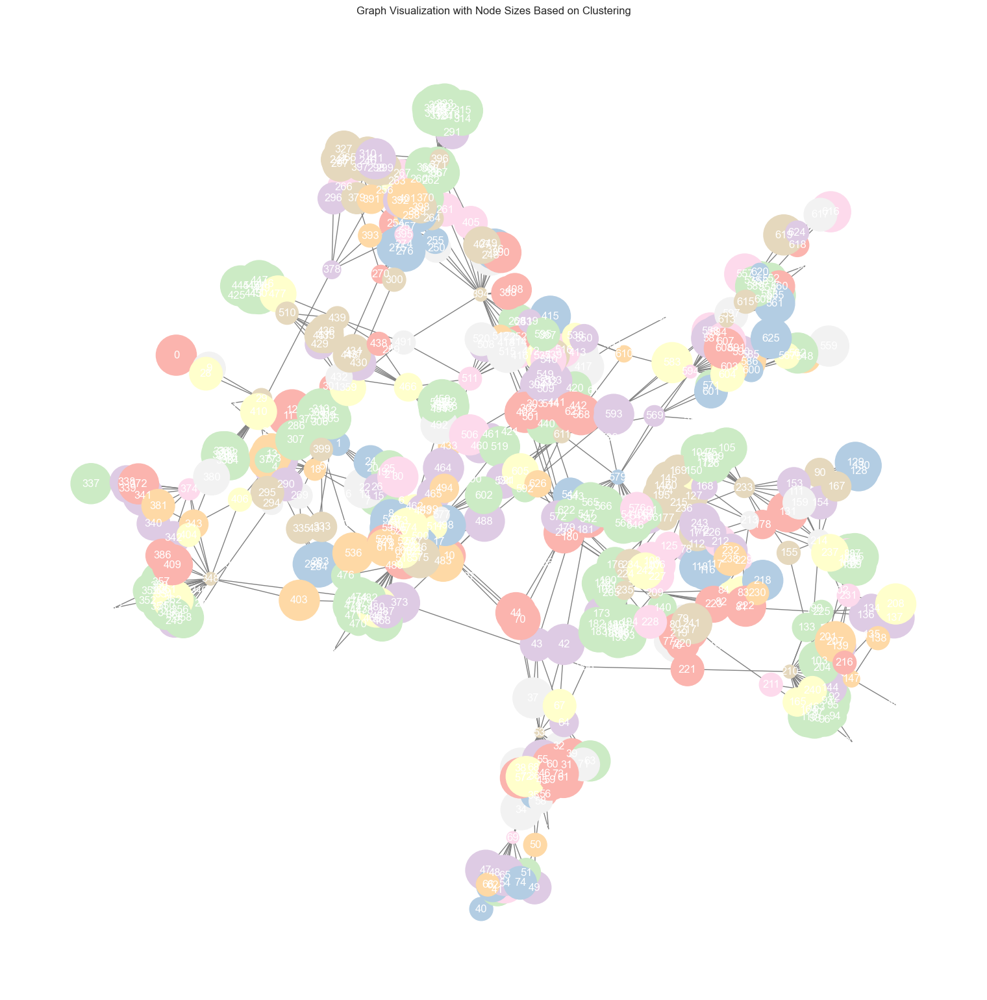

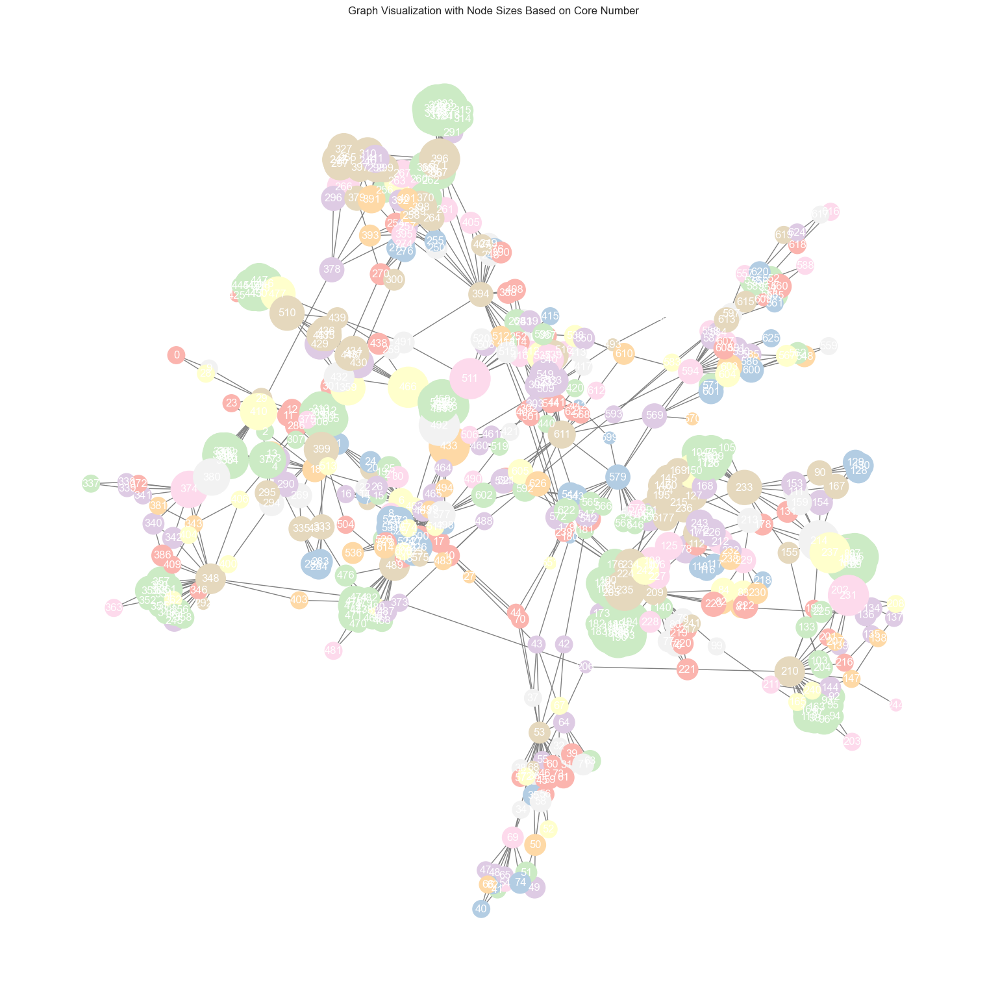

In [100]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from pandas.plotting import parallel_coordinates
import numpy as np
import networkx as nx

# Read your data
graph_merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv")
new_filtered_merge_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
merged_vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Network stats columns
network_stats_columns = ['Degree Centrality', 'Closeness Centrality', 'Betweenness Centrality', 'PageRank', 'Clustering', 'Core Number']

# Normalize the data
scaler = MinMaxScaler()
network_stats_df = graph_merged_nodes[network_stats_columns]
network_stats_normalized = pd.DataFrame(scaler.fit_transform(network_stats_df), columns=network_stats_columns)
network_stats_normalized['Room Name'] = graph_merged_nodes['Room Name']
network_stats_normalized['Level'] = graph_merged_nodes['Level'].astype('category')

# Use pastel color map for room names
color_map_pastel = sns.color_palette("Pastel1", len(unique_room_names))
room_name_to_color_pastel = {name: color_map_pastel[i] for i, name in enumerate(unique_room_names)}

# Identify nodes that are not connected to any edge
isolated_nodes = list(nx.isolates(G))

# ... (The rest of your existing code remains the same)
# ...

# Remove small disconnected subgraphs (smaller than the largest connected component)
largest_cc = max(nx.connected_components(G), key=len)
G = G.subgraph(largest_cc).copy()

# Re-create the graph visualizations with the previous layout settings
for col in network_stats_columns:
    plt.figure(figsize=(15, 15))
    
    # Filter out isolated nodes and nodes in small subgraphs
    filtered_node_indices = [idx for idx in graph_merged_nodes['Index'] if idx in largest_cc]
    filtered_graph_merged_nodes = graph_merged_nodes[graph_merged_nodes['Index'].isin(filtered_node_indices)]
    
    node_sizes = (network_stats_normalized.loc[filtered_graph_merged_nodes.index, col] * 2000).tolist()
    node_colors = [room_name_to_color_pastel[name] for name in filtered_graph_merged_nodes['Room Name']]
    
    # Draw the graph with the default spring layout settings
    pos = nx.spring_layout(G, seed=42)
    nx.draw(G, pos, node_size=node_sizes, node_color=node_colors, edge_color='grey', 
            with_labels=True, font_size=12, font_color='white')
    
    plt.title(f'Graph Visualization with Node Sizes Based on {col}')
    plt.show()





In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from pandas.plotting import parallel_coordinates
import numpy as np
import networkx as nx

# Read your data
graph_merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv")
new_filtered_merge_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
merged_vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Network stats columns
network_stats_columns = ['Degree Centrality', 'Closeness Centrality', 'Betweenness Centrality', 'PageRank', 'Clustering', 'Core Number']

# Normalize the data
scaler = MinMaxScaler()
network_stats_df = graph_merged_nodes[network_stats_columns]
network_stats_normalized = pd.DataFrame(scaler.fit_transform(network_stats_df), columns=network_stats_columns)
network_stats_normalized['Room Name'] = graph_merged_nodes['Room Name']
network_stats_normalized['Level'] = graph_merged_nodes['Level'].astype('category')

# Create the graph
node_indices = graph_merged_nodes['Index'].tolist()
G = nx.Graph()
all_edges = pd.concat([new_filtered_merge_edgelist, merged_vertical_edgelist])
edges = [(row['vi'], row['vj']) for _, row in all_edges.iterrows()]
G.add_nodes_from(node_indices)
G.add_edges_from(edges)

# Identify and remove isolated nodes
isolated_nodes = list(nx.isolates(G))
G.remove_nodes_from(isolated_nodes)

# Identify the largest connected component and focus on that
largest_cc = max(nx.connected_components(G), key=len)
G = G.subgraph(largest_cc).copy()

# Use pastel color map for room names
unique_room_names = graph_merged_nodes['Room Name'].unique()
color_map_pastel = sns.color_palette("Pastel1", len(unique_room_names))
room_name_to_color_pastel = {name: color_map_pastel[i] for i, name in enumerate(unique_room_names)}

# Re-create the graph visualizations with the updated layout settings
for col in network_stats_columns:
    plt.figure(figsize=(15, 15))
    
    # Filter out isolated nodes and nodes in small subgraphs
    filtered_node_indices = [idx for idx in graph_merged_nodes['Index'] if idx in largest_cc]
    filtered_graph_merged_nodes = graph_merged_nodes[graph_merged_nodes['Index'].isin(filtered_node_indices)]
    
    # Make the nodes 10% larger
    node_sizes = (network_stats_normalized.loc[filtered_graph_merged_nodes.index, col] * 1800).tolist()
    node_colors = [room_name_to_color_pastel[name] for name in filtered_graph_merged_nodes['Room Name']]
    
    # Draw the graph with the spring layout
    pos = nx.spring_layout(G, seed=42, k=0.1)
    nx.draw(G, pos, node_size=node_sizes, node_color=node_colors, edge_color='grey', 
            with_labels=True, font_size=12, font_color='white')
    
    plt.title(f'Graph Visualization with Node Sizes Based on {col}')
    plt.show()


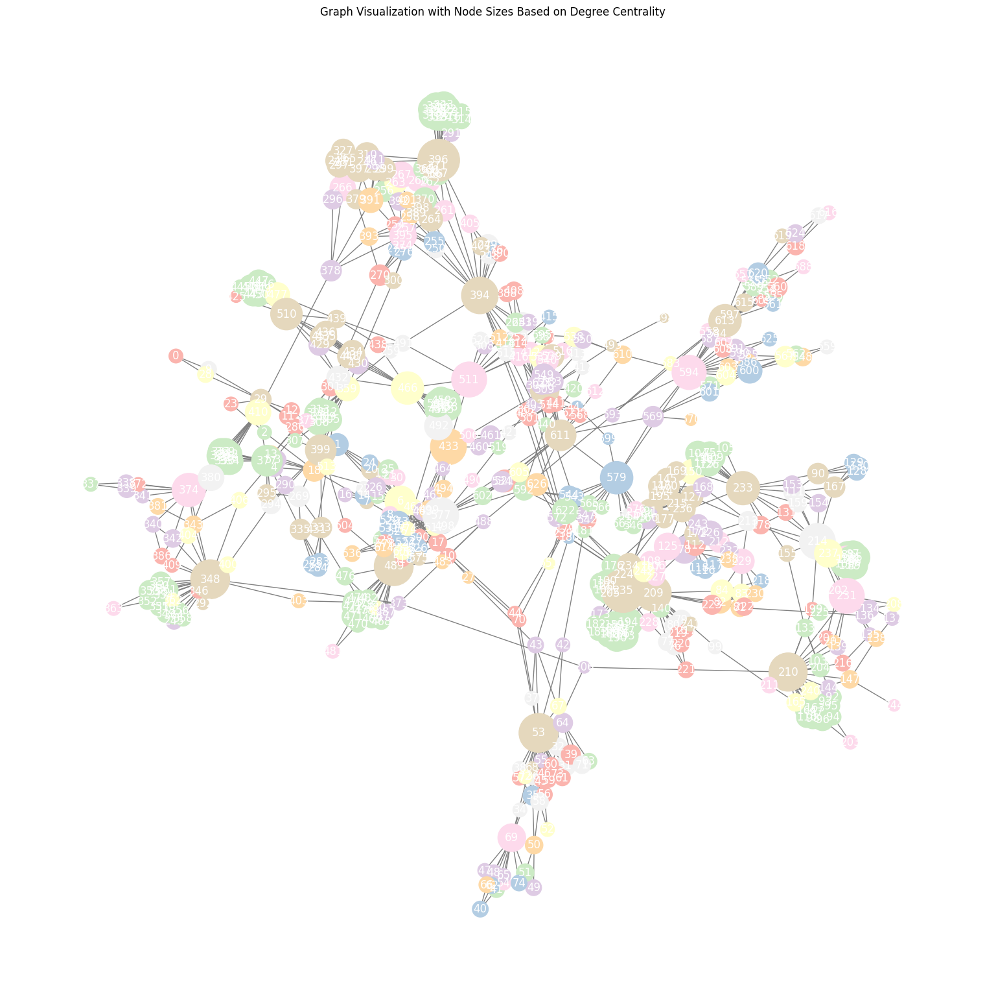

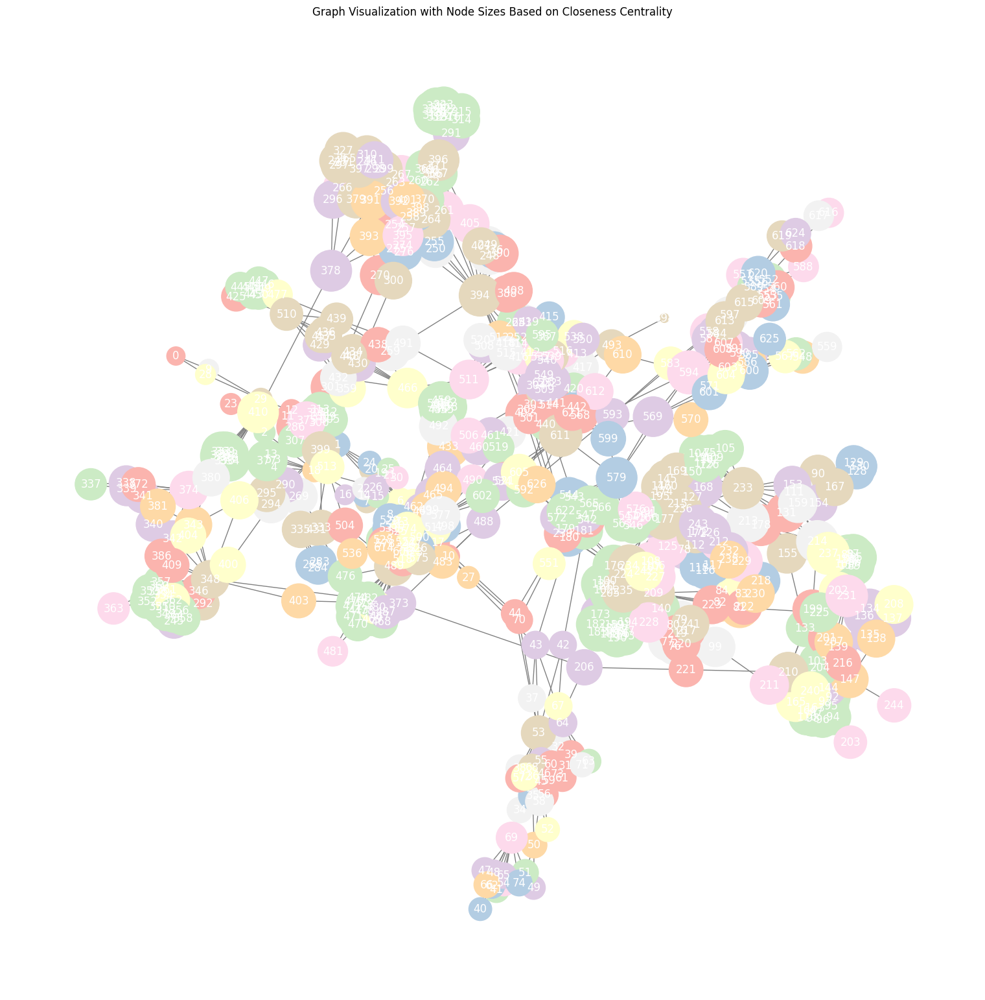

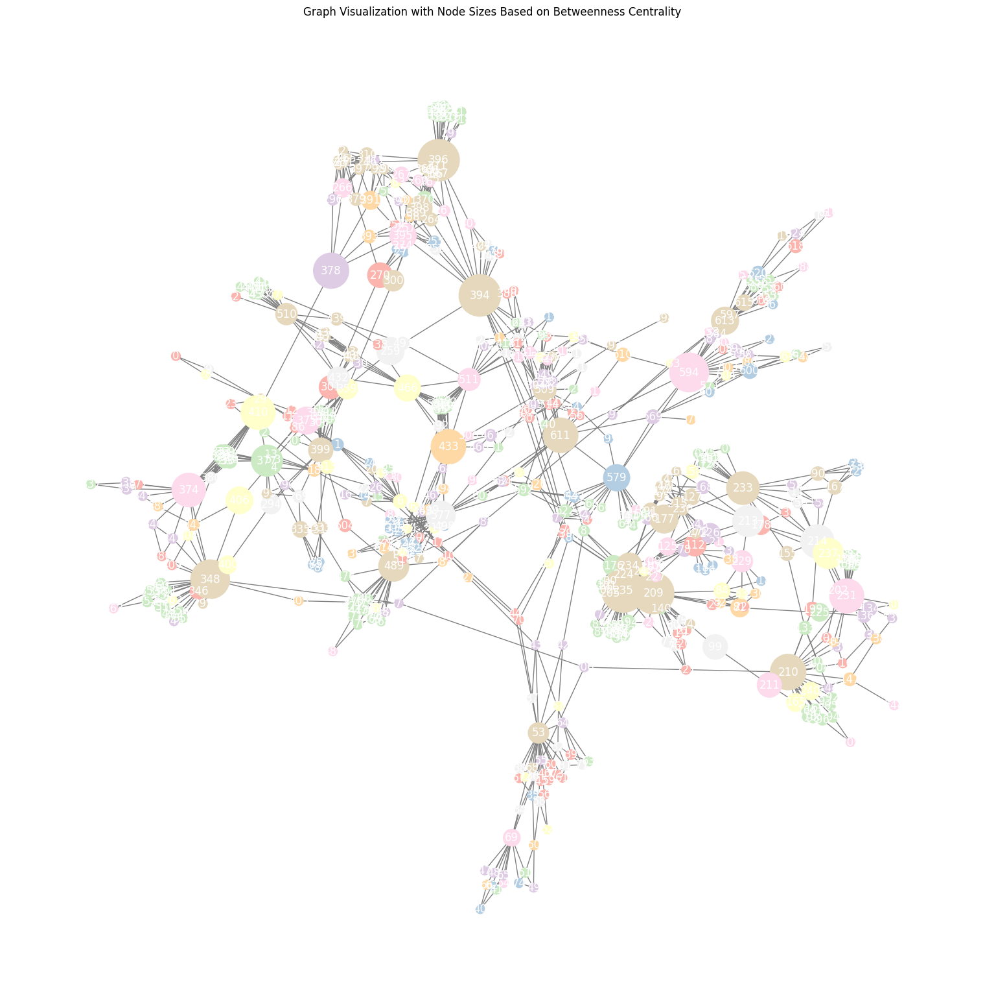

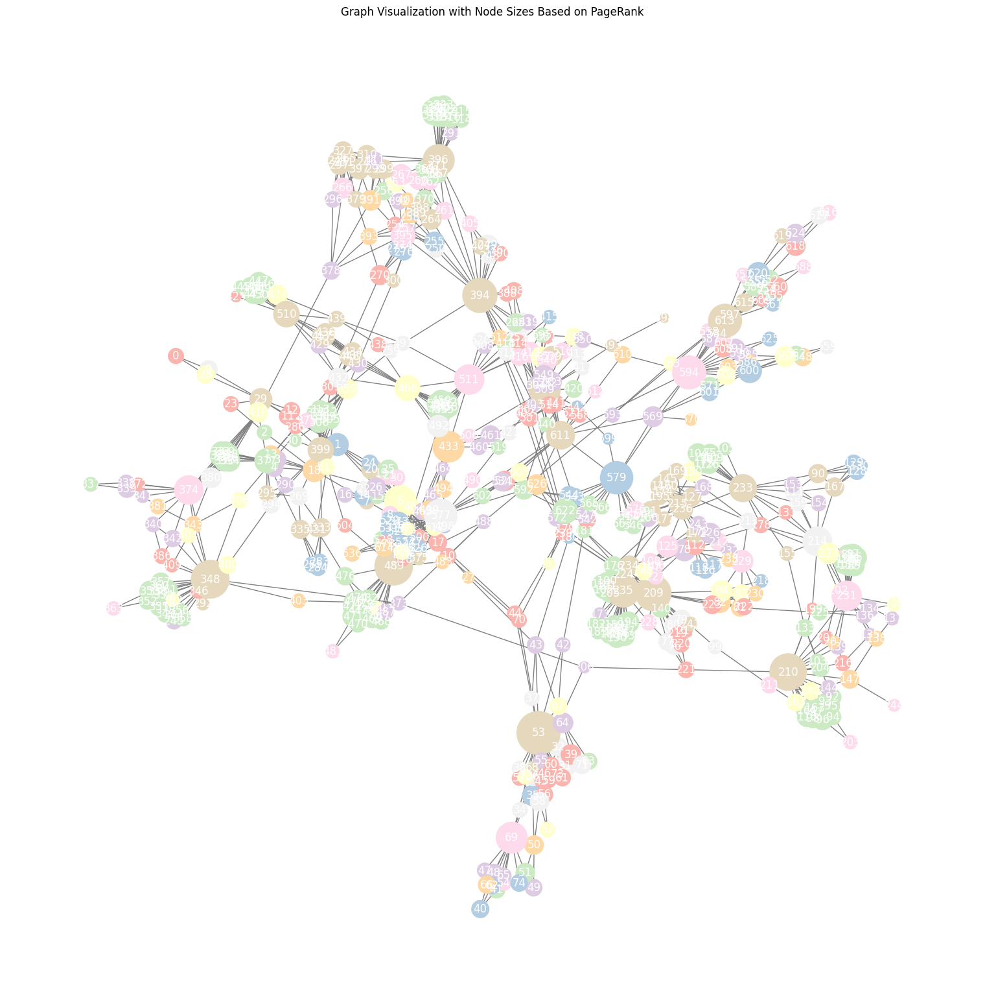

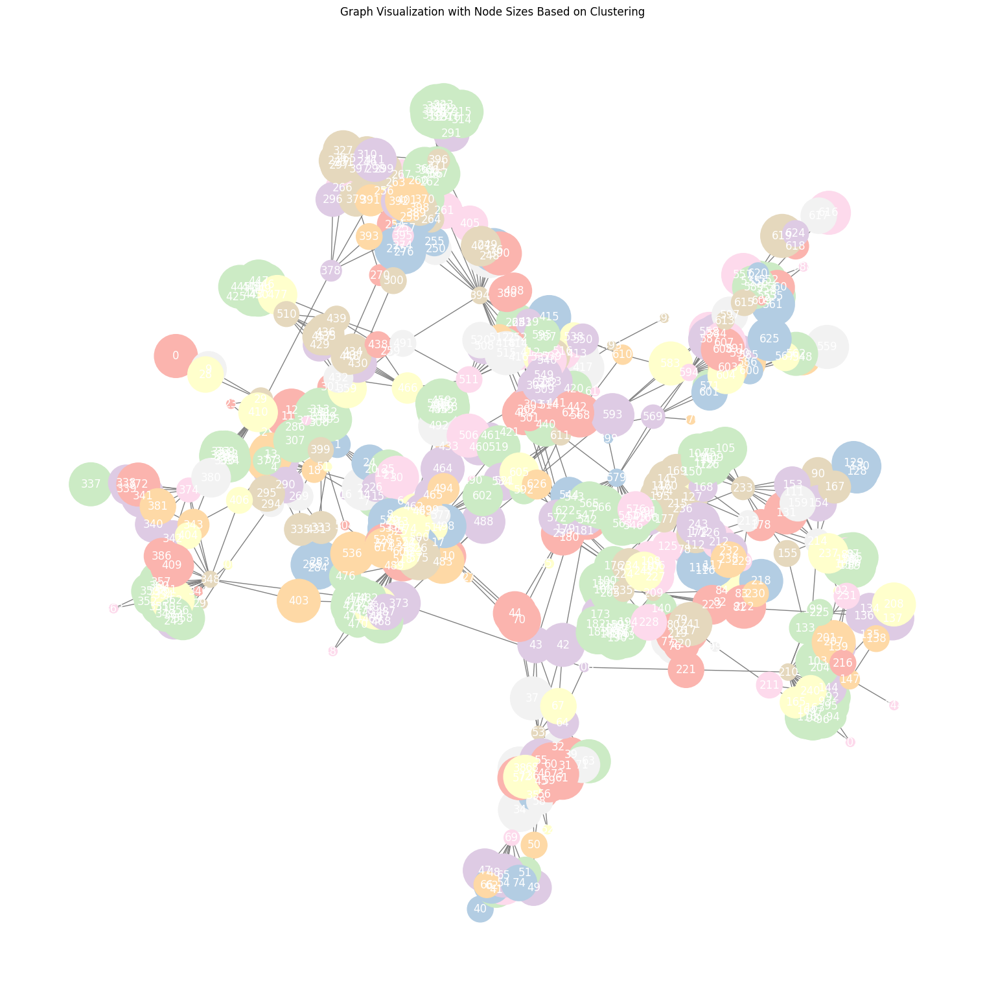

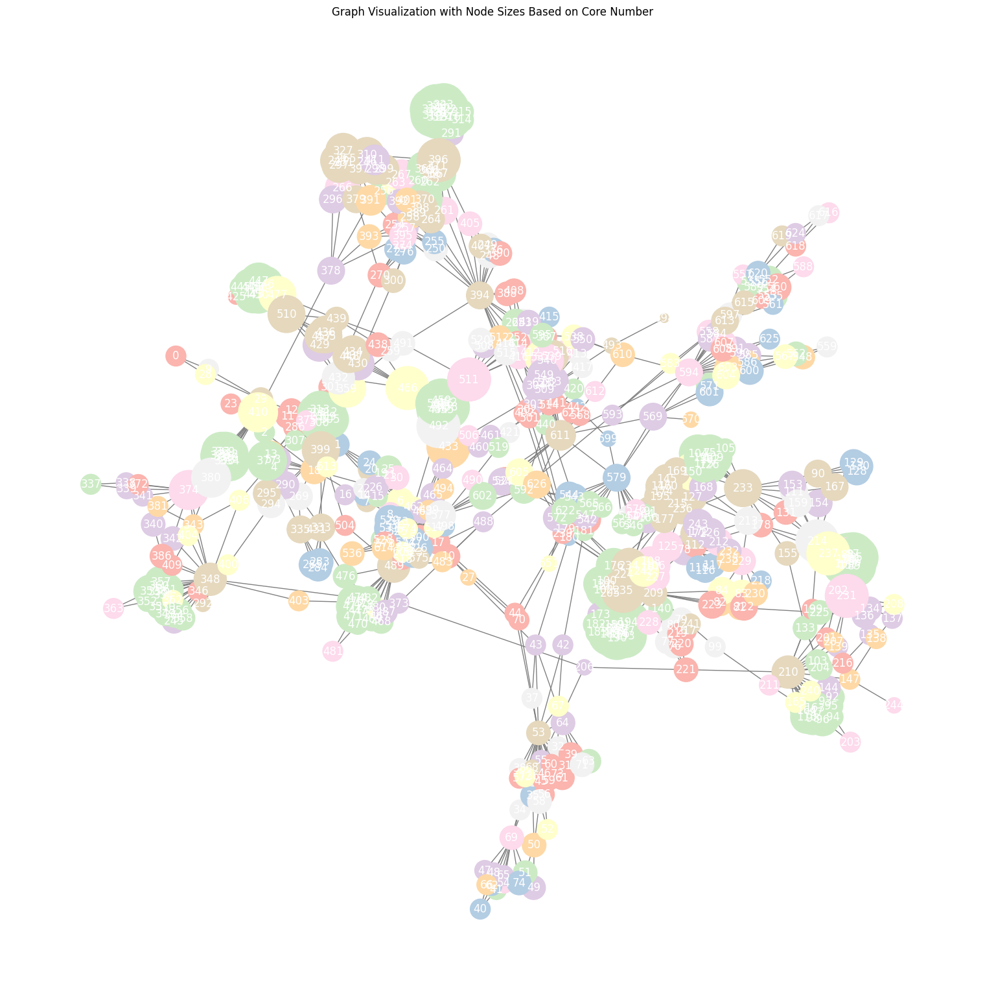

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from pandas.plotting import parallel_coordinates
import numpy as np
import networkx as nx

# Read your data
graph_merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv")
new_filtered_merge_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
merged_vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Network stats columns
network_stats_columns = ['Degree Centrality', 'Closeness Centrality', 'Betweenness Centrality', 'PageRank', 'Clustering', 'Core Number']

# Normalize the data
scaler = MinMaxScaler()
network_stats_df = graph_merged_nodes[network_stats_columns]
network_stats_normalized = pd.DataFrame(scaler.fit_transform(network_stats_df), columns=network_stats_columns)
network_stats_normalized['Room Name'] = graph_merged_nodes['Room Name']
network_stats_normalized['Level'] = graph_merged_nodes['Level'].astype('category')

# Create the graph
node_indices = graph_merged_nodes['Index'].tolist()
G = nx.Graph()
all_edges = pd.concat([new_filtered_merge_edgelist, merged_vertical_edgelist])
edges = [(row['vi'], row['vj']) for _, row in all_edges.iterrows()]
G.add_nodes_from(node_indices)
G.add_edges_from(edges)

# Identify and remove isolated nodes
isolated_nodes = list(nx.isolates(G))
G.remove_nodes_from(isolated_nodes)

# Identify the largest connected component and focus on that
largest_cc = max(nx.connected_components(G), key=len)
G = G.subgraph(largest_cc).copy()

# Use pastel color map for room names
unique_room_names = graph_merged_nodes['Room Name'].unique()
color_map_pastel = sns.color_palette("Pastel1", len(unique_room_names))
room_name_to_color_pastel = {name: color_map_pastel[i] for i, name in enumerate(unique_room_names)}

# Re-create the graph visualizations with the updated layout settings
for col in network_stats_columns:
    plt.figure(figsize=(15, 15))
    
    # Filter out isolated nodes and nodes in small subgraphs
    filtered_node_indices = [idx for idx in graph_merged_nodes['Index'] if idx in largest_cc]
    filtered_graph_merged_nodes = graph_merged_nodes[graph_merged_nodes['Index'].isin(filtered_node_indices)]
    
    # Make the nodes 10% larger
    node_sizes = (network_stats_normalized.loc[filtered_graph_merged_nodes.index, col] * 2200 + 100).tolist()
    node_colors = [room_name_to_color_pastel[name] for name in filtered_graph_merged_nodes['Room Name']]
    
    # Draw the graph with the spring layout
    pos = nx.spring_layout(G, seed=42)
    nx.draw(G, pos, node_size=node_sizes, node_color=node_colors, edge_color='grey', 
            with_labels=True, font_size=12, font_color='white')
    
    plt.title(f'Graph Visualization with Node Sizes Based on {col}')
    plt.show()


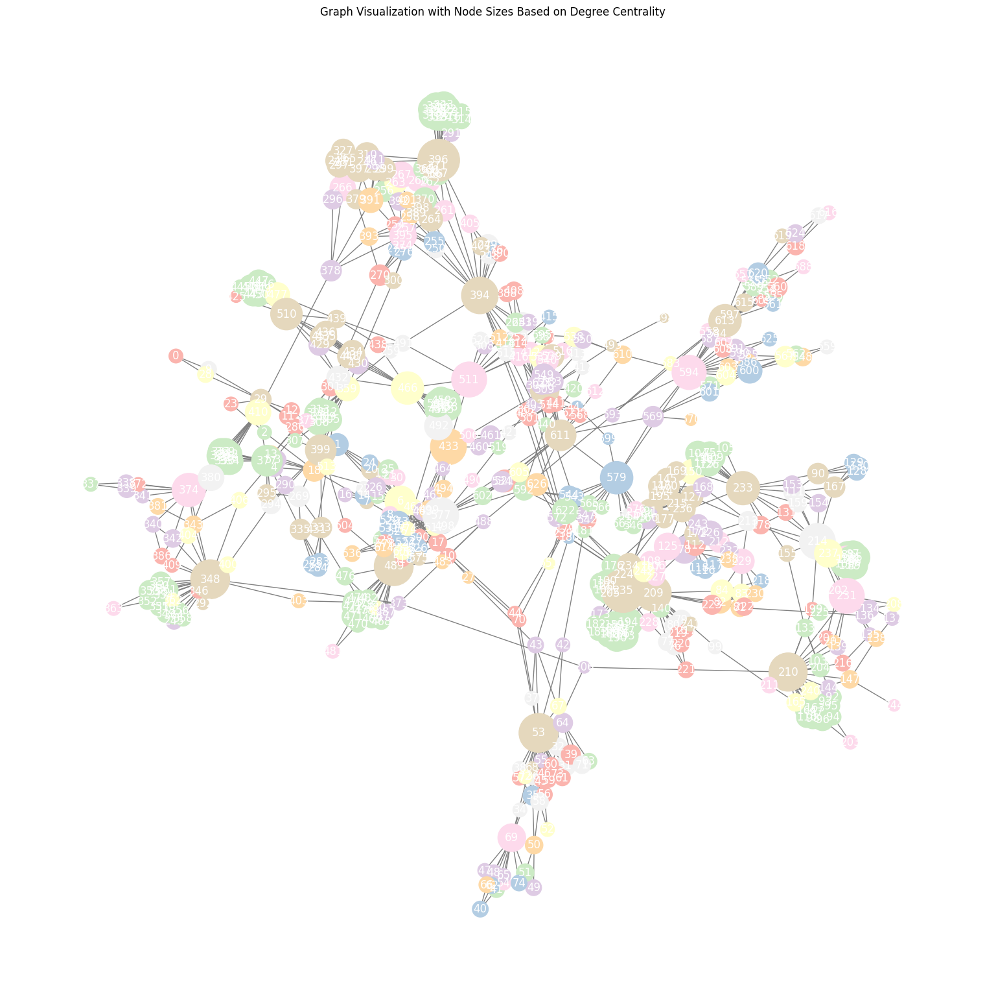

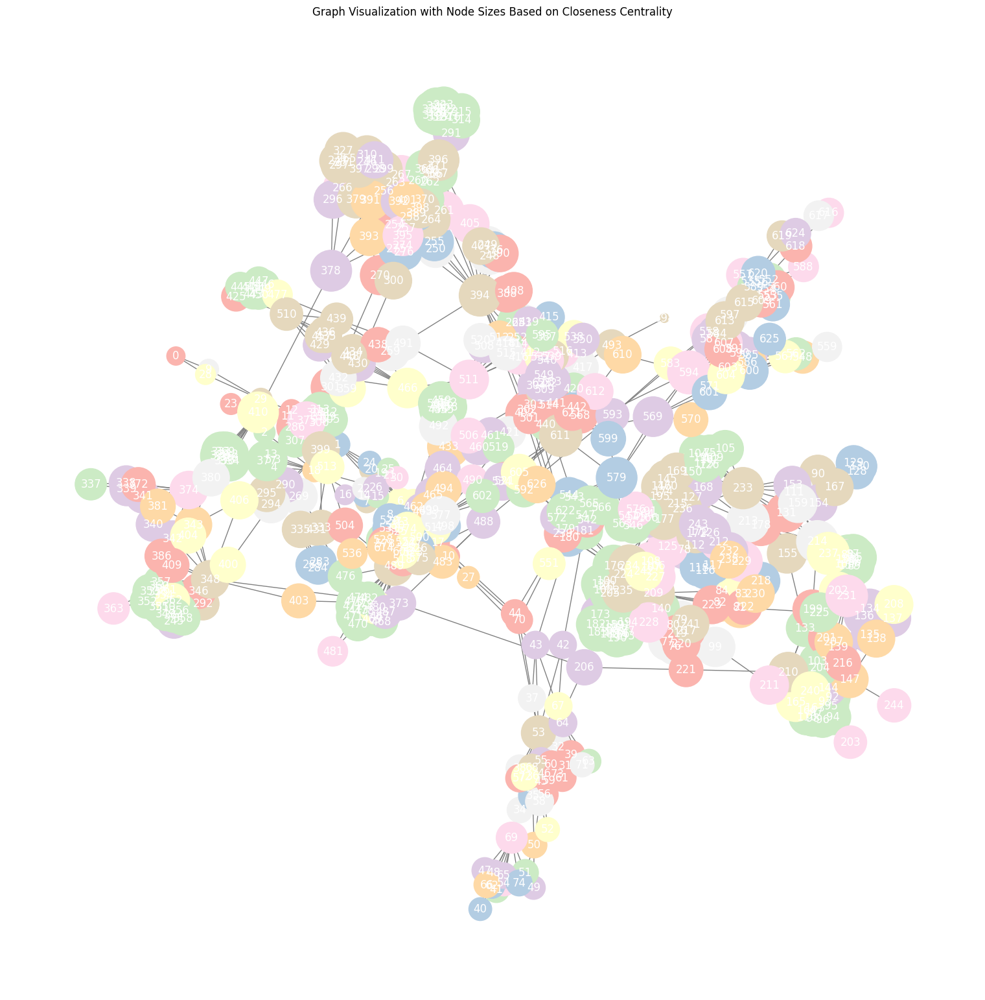

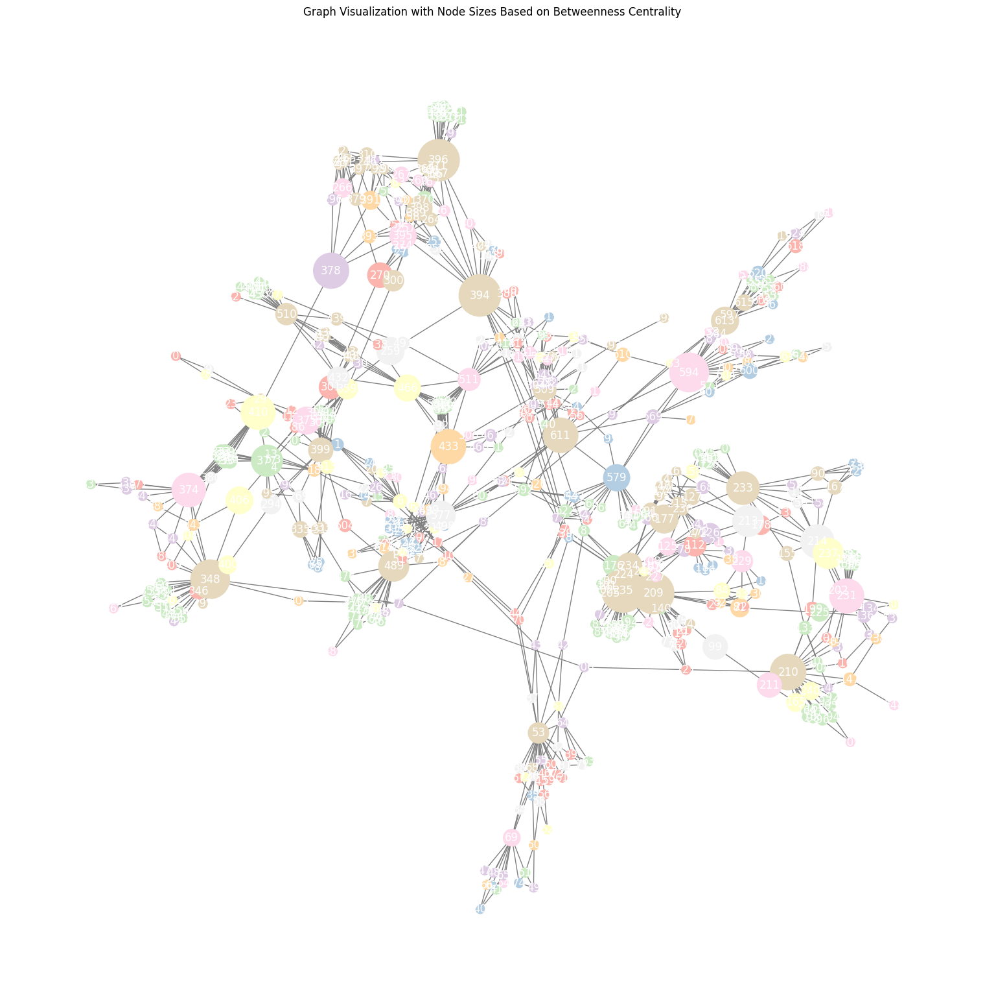

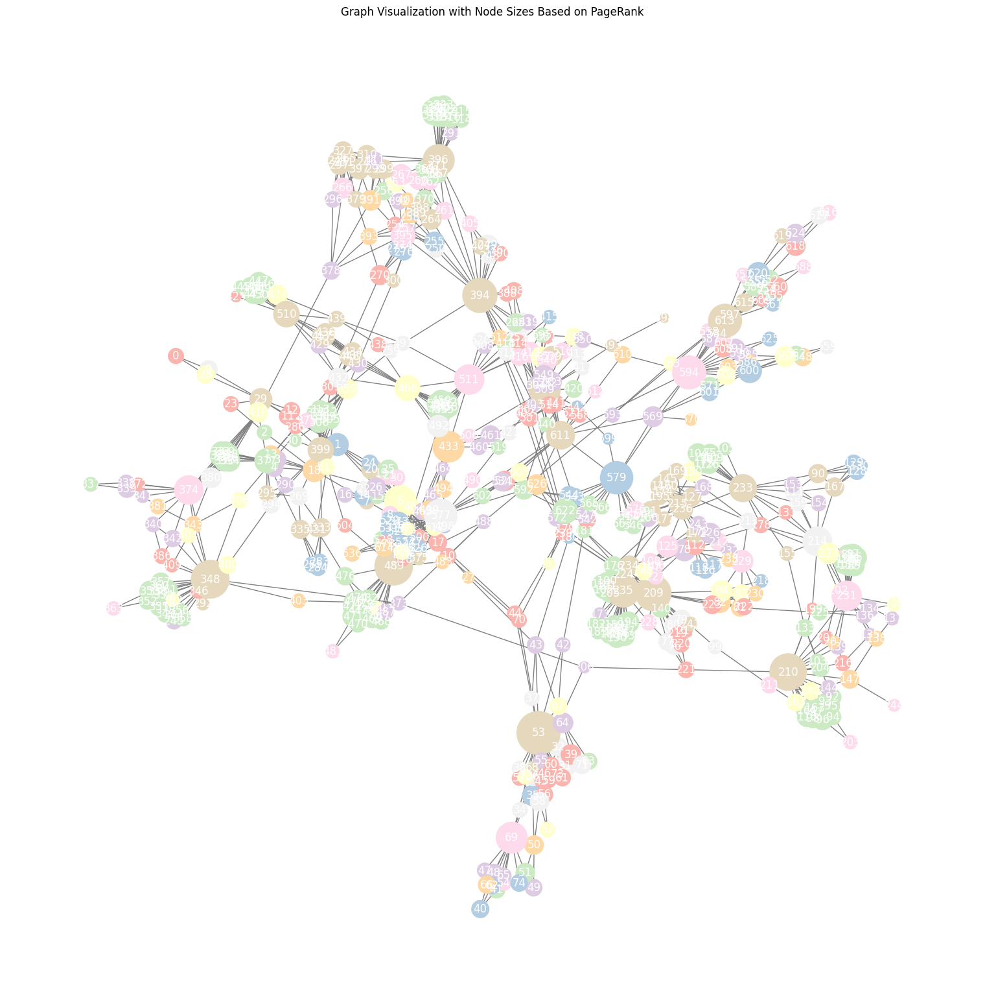

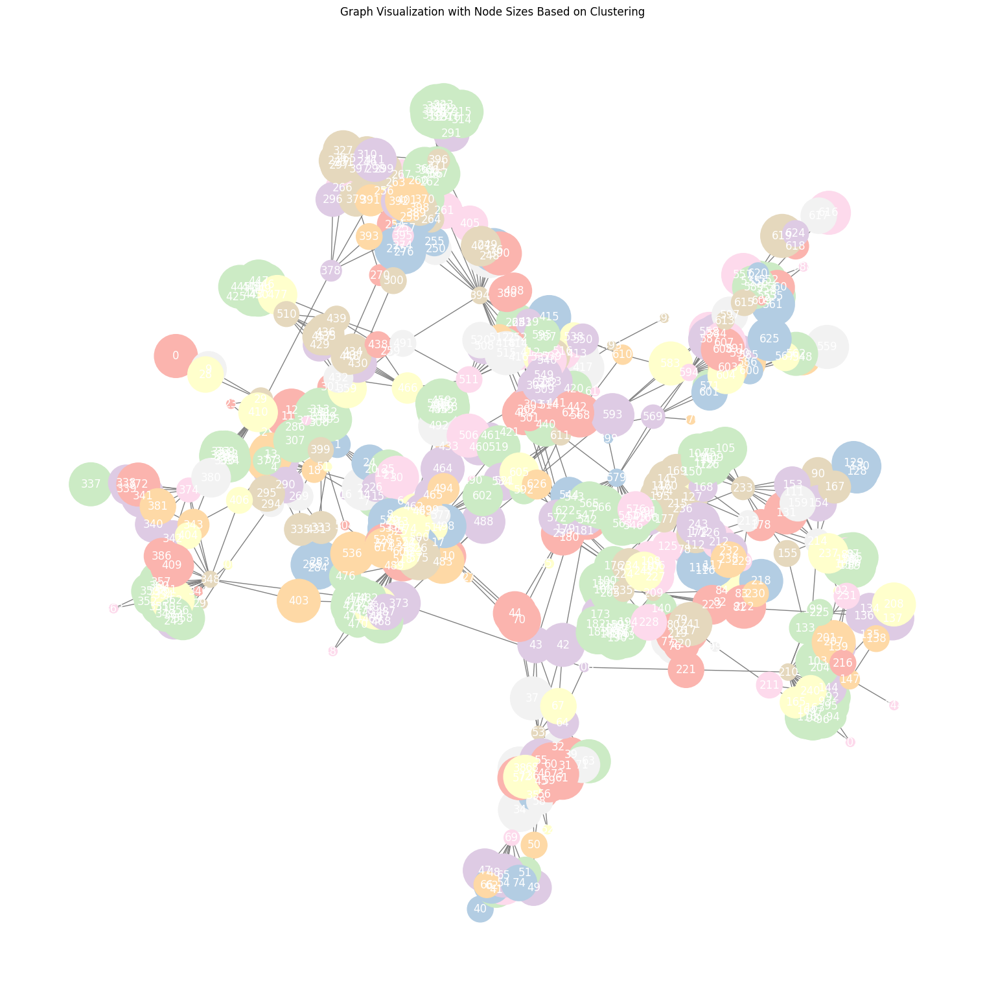

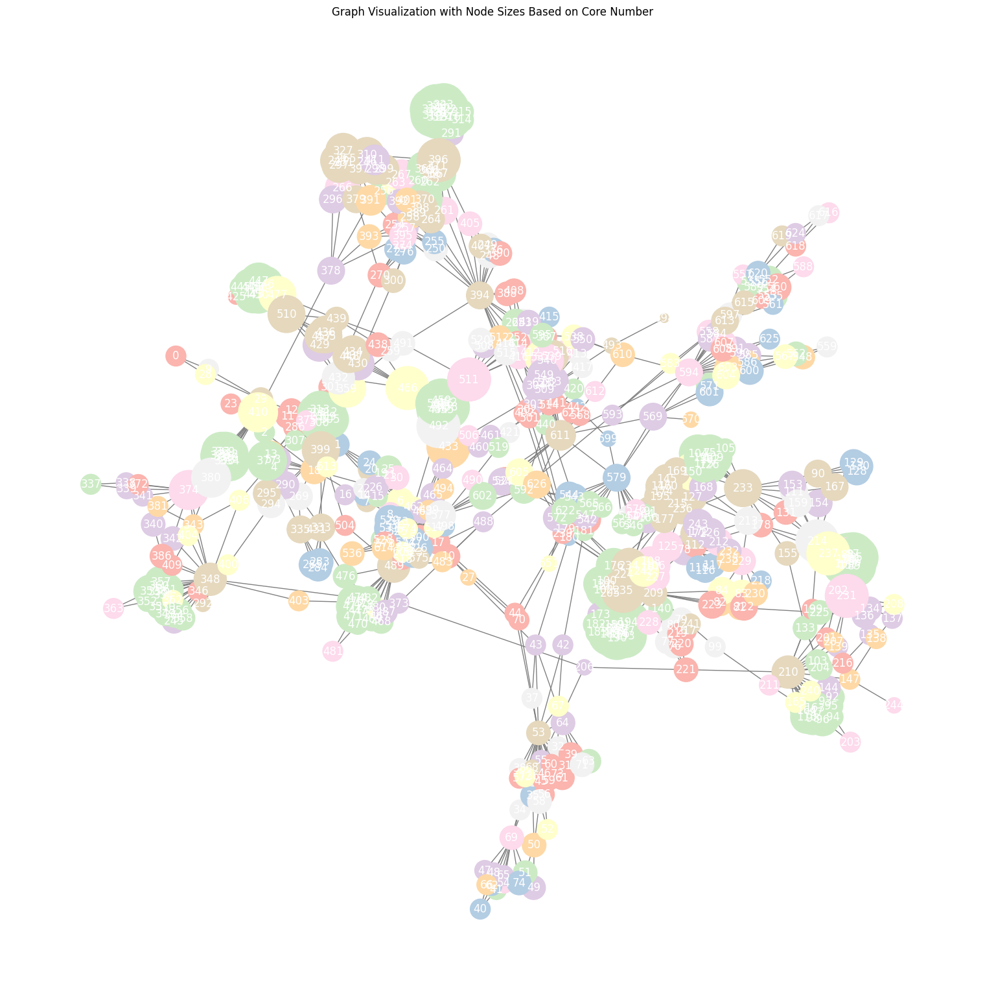

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import networkx as nx

# Read your data
graph_merged_nodes = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv")
new_filtered_merge_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv")
merged_vertical_edgelist = pd.read_csv("C:\\Users\\Georgios Bekakos\\Desktop\\merged_vertical_edgelist.csv")

# Network stats columns
network_stats_columns = ['Degree Centrality', 'Closeness Centrality', 'Betweenness Centrality', 'PageRank', 'Clustering', 'Core Number']

# Normalize the data
scaler = MinMaxScaler()
network_stats_df = graph_merged_nodes[network_stats_columns]
network_stats_normalized = pd.DataFrame(scaler.fit_transform(network_stats_df), columns=network_stats_columns)
network_stats_normalized['Room Name'] = graph_merged_nodes['Room Name']
network_stats_normalized['Level'] = graph_merged_nodes['Level'].astype('category')

# Create the graph
node_indices = graph_merged_nodes['Index'].tolist()
G = nx.Graph()
all_edges = pd.concat([new_filtered_merge_edgelist, merged_vertical_edgelist])
edges = [(row['vi'], row['vj']) for _, row in all_edges.iterrows()]
G.add_nodes_from(node_indices)
G.add_edges_from(edges)

# Identify and remove isolated nodes
isolated_nodes = list(nx.isolates(G))
G.remove_nodes_from(isolated_nodes)

# Identify the largest connected component and focus on that
largest_cc = max(nx.connected_components(G), key=len)
G = G.subgraph(largest_cc).copy()

# Use pastel color map for room names
unique_room_names = graph_merged_nodes['Room Name'].unique()
color_map_pastel = sns.color_palette("Pastel1", len(unique_room_names))
room_name_to_color_pastel = {name: color_map_pastel[i] for i, name in enumerate(unique_room_names)}

# Re-create the graph visualizations with the updated layout settings
for col in network_stats_columns:
    plt.figure(figsize=(15, 15))
    
    # Filter out isolated nodes and nodes in small subgraphs
    filtered_node_indices = [idx for idx in graph_merged_nodes['Index'] if idx in largest_cc]
    filtered_graph_merged_nodes = graph_merged_nodes[graph_merged_nodes['Index'].isin(filtered_node_indices)]
    
    # Make the nodes 10% larger
    node_sizes = (network_stats_normalized.loc[filtered_graph_merged_nodes.index, col] * 2200 + 100).tolist()
    node_colors = [room_name_to_color_pastel[name] for name in filtered_graph_merged_nodes['Room Name']]
    
    # Draw the graph with the spring layout
    pos = nx.spring_layout(G, seed=42)
    nx.draw(G, pos, node_size=node_sizes, node_color=node_colors, edge_color='grey', 
            with_labels=True, font_size=12, font_color='white')
    
    plt.title(f'Graph Visualization with Node Sizes Based on {col}')
    plt.show()


## ENRICH CSVS

nodes

In [7]:
import pandas as pd
import numpy as np

# Full path to your existing CSV file
input_path = "C:\\Users\\Georgios Bekakos\\Desktop\\graph_merged_nodes.csv"

# Read the existing DataFrame from CSV
graph_merged_nodes = pd.read_csv(input_path)

# Step 1: Create Program Amplifier based on Room Name
def assign_amplifier(row):
    room_name = row['Room Name']
    if pd.isnull(room_name):
        return 0
    if any(word in room_name for word in ["CORR", "ATRIUM", "AUDITORIUM", "ELEVATOR", "PUBLIC", "STAIR", "STAIR 01", "STAIR 02", "STAIR 03", "STAIR 04"]):
        return 5
    elif any(word in room_name for word in ["CLASSROOM", "LAB", "RESEARCH"]):
        return 4
    elif any(word in room_name for word in ["OFFICE", "WS"]):
        return 3
    elif "ADMIN" in room_name or "STAFF" in room_name:
        return 2
    elif "STORAGE" in room_name or "TOILET" in room_name:
        return 1
    else:
        return 0

graph_merged_nodes['Program Amplifier'] = graph_merged_nodes.apply(assign_amplifier, axis=1)

# Step 2: Create Initial Circulation Index
weights = {
    'Degree Centrality': 0.2,
    'Closeness Centrality': 0.2,
    'Betweenness Centrality': 0.2,
    'PageRank': 0.2,
    'Clustering': 0.1,
    'Core Number': 0.1
}

graph_merged_nodes['Initial Circulation Index'] = graph_merged_nodes.apply(lambda row: np.sum([row[metric] * weight for metric, weight in weights.items()]), axis=1)

# Step 3: Create Circulation Index
graph_merged_nodes['Circulation Index'] = graph_merged_nodes['Initial Circulation Index'] + (graph_merged_nodes['Initial Circulation Index'] * (graph_merged_nodes['Program Amplifier'] / 10))

# Step 4: Calculate Occupancy based on Area and Program Amplifier
def assign_occupancy(row):
    area = row['Area']
    amplifier = row['Program Amplifier']
    if pd.isnull(area):
        return 0
    if amplifier == 5:  # Public spaces
        return area // 2.5
    elif amplifier == 4:  # Classrooms, labs, research spaces
        return area // 2
    elif amplifier == 3:  # Offices, workspaces
        return area // 4
    elif amplifier == 2:  # Admin, Staff
        return area // 5
    elif amplifier == 1:  # Storage, Toilet
        return area // 6
    else:
        return area // 3

graph_merged_nodes['Occupancy'] = graph_merged_nodes.apply(assign_occupancy, axis=1)

# Check for unwanted column "Unnamed: 15" and remove if exists
if 'Unnamed: 15' in graph_merged_nodes.columns:
    del graph_merged_nodes['Unnamed: 15']

# Full path to your new enriched CSV file
output_path = "C:\\Users\\Georgios Bekakos\\Desktop\\enriched_graph_merged_nodes.csv"

# Export the enriched DataFrame to a new CSV file
graph_merged_nodes.to_csv(output_path, index=False)


In [9]:
import os
import pandas as pd

def join_csv_by_level(directory, level):
    combined_df = pd.DataFrame()

    prefixes = [
        "roomnames",  # Making roomnames the first column
        "daylightfactor",
        "standardeffectivetemperature",
        "predictedmeanvote",
        "generalcomfort",
        "thermalstatusdryhumid"
    ]
    
    for prefix in prefixes:
        file_path = os.path.join(directory, f"{prefix}_level{level}.csv")
        
        if os.path.exists(file_path):
            # Specify header=None to ensure the first row is not considered as a header
            temp_df = pd.read_csv(file_path, header=None)
            temp_df.columns = [prefix]
            
            if combined_df.empty:
                combined_df = temp_df
            else:
                combined_df = pd.concat([combined_df, temp_df], axis=1)
    
    # Add a 'Level' column and populate it for each row
    combined_df['Level'] = level
    
    return combined_df

# Initialize an empty DataFrame to store the final combined data
final_combined_df = pd.DataFrame()

# Directory where the CSV files are located
directory = "C:\\Users\\Georgios Bekakos\\Desktop\\GH\\gh_excels\\finalized"

# Loop through each level and join CSVs
for level in range(1, 7):
    combined_df_level = join_csv_by_level(directory, level)
    
    final_combined_df = pd.concat([final_combined_df, combined_df_level], axis=0)

# Save the final combined dataframe to a new CSV file
final_combined_df.to_csv(os.path.join(directory, "final_combined_with_levels.csv"), index=False)


In [10]:
import os
import pandas as pd

def join_special_csv(directory, filenames):
    combined_df = pd.DataFrame()
    
    for filename in filenames:
        file_path = os.path.join(directory, f"{filename}.csv")
        
        if os.path.exists(file_path):
            # Specify header=None to ensure the first row is not considered as a header
            temp_df = pd.read_csv(file_path, header=None)
            temp_df.columns = [filename]
            
            if combined_df.empty:
                combined_df = temp_df
            else:
                combined_df = pd.concat([combined_df, temp_df], axis=1)
                
    return combined_df

# Directory where the CSV files are located
directory = "C:\\Users\\Georgios Bekakos\\Desktop\\GH\\gh_excels\\finalized"

# Filenames to be joined
filenames = ["incidentradiation_all", "roomnames_all", "sunlighthours_all"]

# Join the CSVs
combined_df = join_special_csv(directory, filenames)

# Save the final combined dataframe to a new CSV file
combined_df.to_csv(os.path.join(directory, "special_combined_all.csv"), index=False)


edges

In [4]:
import pandas as pd
from scipy.spatial import distance
import ast

# Replace these with the full paths to the files on your desktop
nodes_filepath = "C:\\Users\\Georgios Bekakos\\Desktop\\enriched_graph_merged_nodes.csv"
edgelist_filepath = "C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist.csv"

# Read the node and edge data
nodes_df = pd.read_csv(nodes_filepath)
edgelist_df = pd.read_csv(edgelist_filepath)

# Convert the Centroid column from string to actual tuples
nodes_df['Centroid'] = nodes_df['Centroid'].apply(ast.literal_eval)

# Create a dictionary mapping node index to centroid
node_to_centroid = {row['Index']: row['Centroid'] for _, row in nodes_df.iterrows()}

# Calculate the centroid distances for each edge and store them in a new column
edgelist_df['Connecting Centroids Distance'] = edgelist_df.apply(
    lambda row: distance.euclidean(node_to_centroid[row['vi']], node_to_centroid[row['vj']]),
    axis=1
)

# Write the updated edgelist back to your desktop
output_filepath = "C:\\Users\\Georgios Bekakos\\Desktop\\new_filtered_merge_edgelist_updated.csv"
edgelist_df.to_csv(output_filepath, index=False)


In [9]:
import pandas as pd

# Reading the CSV file from the specified path
file_path = r'C:\Users\Georgios Bekakos\Desktop\merged_vertical_edgelist.csv'  # Replace 'your_file.csv' with your actual file name
merged_vertical_edgelist = pd.read_csv(file_path)

# Adding a new column named 'Connecting Centroids Distance' with all values set to 4
merged_vertical_edgelist['Connecting Centroids Distance'] = 4

# Saving the updated DataFrame back to the same CSV file
merged_vertical_edgelist.to_csv(file_path, index=False)
